# Prédiction de la gravité d'un accident de la route en France en 2021

## Introduction 

Pour chaque accident corporel (soit un accident survenu sur une voie ouverte à la circulation publique, impliquant au moins un véhicule et ayant fait au moins une victime ayant nécessité des soins), des saisies d’information décrivant l’accident sont effectuées par l’unité des forces de l’ordre (police, gendarmerie, etc.) qui est intervenue sur le lieu de l’accident. Ces saisies sont rassemblées dans une fiche intitulée bulletin d’analyse des accidents corporels. L’ensemble de ces fiches constitue le fichier national des accidents corporels de la circulation dit « Fichier BAAC » administré par l’Observatoire national interministériel de la sécurité routière "ONISR". Ces bases occultent néanmoins certaines données spécifiques relatives aux usagers et aux véhicules et à leur comportement dans la mesure où la divulgation de ces données porterait atteinte à la protection de la vie privée des personnes physiques. 

Nous avons choisi de réaliser un projet consistant à prédire la gravité (sévérité) d'un accident de la route en France en se servant d'un jeu de ddonnées de l'année 2021 car c'est un enjeu d'intérêt publique. En effet, nous souhaitions appliquer des modèles de Machine Learning à un problème concret en se servant de bases de données fournies par le gouvernement afin de se rendre compte de l'utilité de la Data Science et du Machine Learning pour résoudre des problématiques dans des domaines divers et variés. 

De plus, il nous semblait intéressant d'étudier ce problème car c'est un problème de Machine Learning faisant appel à beaucoup de techniques différetes pour bien appréhender le sujet (nécessité de gérer dataset déséquilibré avec peu d'accidents mortels par exemple, choix des features importants car peu d'information précise pouvant faciliter la prédiction avec par exemple l'absence de la vitesse du véhicule au moment de l'accident qui faciliterait grandement la prédiction). 

Nous avons donc réalisé un modèle d'apprentissage supervisé où nous avions le label correspondant à la gravité de l'accident. L'entraînement de notre modèle nous permet ensuite de prédire avec une certaine précision (environ 73%) la gravité de l'accident en fonction de certains features. La gravité correspond à l'état indemne, l'état blessé léger, blessé hospitalisé ou tué lors de l'accident. 

En effet, selon la description des bases de données fournit par le gouvernement, nous pouvons définir plus précisément un accident corporel et les types de victime possibles. 

Un accident corporel (mortel et non mortel) de la circulation routière relevé par les forces de l’ordre :

- implique au moins une victime,

- survient sur une voie publique ou privée, ouverte à la circulation publique, 

- implique au moins un véhicule.

Un accident corporel implique un certain nombre d’usagers. Parmi ceux-ci, on distingue :

- les personnes indemnes : impliquées non décédées et dont l’état ne nécessite aucun soin médical du fait de l’accident,

- les victimes : impliquées non indemnes, comprenant :   les personnes tuées : personnes qui décèdent du fait de l’accident, sur le coup ou dans les trente jours qui suivent l’accident, et les personnes blessées : victimes non tuées. 

Parmi les personnes blessées, on compte : 

- les blessés dits « hospitalisés » : victimes hospitalisées plus de 24 heures,
            
            
- les blessés légers : victimes ayant fait l'objet de soins médicaux mais n'ayant pas été admises comme patients à l'hôpital plus de 24 heures.

**SOMMAIRE** : 
    
**1) Récupération et nettoyage des données**

**2) Data visualisation et statistiques descriptives**

**3) Data selection**

**4) Modélisation**

**5) Approfondissements : feature importance, feature selection et SHAP**

## Import des modules utiles 

In [2]:
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import numpy as np
plt.style.use('fivethirtyeight')

from datetime import datetime

In [3]:
from sklearn import preprocessing
from sklearn import svm
import sklearn.metrics
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE,SMOTENC
from sklearn.preprocessing import normalize
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score, f1_score
import xgboost
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold

## Récupération et nettoyage des données 

Nous avons essayé de récupérer ces données grâce à une API (nous avons donc étudié le fonctionnement d'une API pednant plusieurs heures) mais le site du gouvernement 'datagouv' ne proposait pas l'API BAAC regroupant les informations sur les lieux, usagers, véhicules et caractéristiques liées aux accidents routiers. 

Le site propose directement, pour chaque année depuis 2005 4 fichiers csv à télécharger pour obtenir des informations sur les accidents : 
1. La rubrique CARACTERISTIQUES qui décrit les circonstances générales de l’accident
2. La rubrique LIEUX qui décrit le lieu principal de l’accident même si celui-ci s’est déroulé à une intersection
3. La rubrique VEHICULES impliqués 
4. La rubrique USAGERS impliqués

In [4]:
# Récupération des 4 datasets séparés à partir de l'url fourni sur le site datagouv.fr

In [5]:
lieux = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/8a4935aa-38cd-43af-bf10-0209d6d17434',sep= ";")
usagers = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/ba5a1956-7e82-41b7-a602-89d7dd484d7a',sep = ';')
vehicules = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/0bb5953a-25d8-46f8-8c25-b5c2f5ba905e', sep= ";")
caracteristiques = pd.read_csv('https://www.data.gouv.fr/fr/datasets/r/85cfdc0c-23e4-4674-9bcd-79a970d7269b',sep = ";")

In [6]:
PATH_GEO_JSON = 'departements-france.geojson'
#écrire le chemin qui mene au dossier départements-france.geojson

In [7]:
# Affichage du nombre de valeurs manquantes pour chaque dataset récupéré

In [8]:
lieux.isnull().sum()
# On constate qu'il manque des données sur les colonnes voie, v2 et lartpc correspondant respectivement au 
# numéro de la route, à la lettre indice alphanumérique de la route et à la Largeur du terre-plein central 
#(TPC) s'il existe (en m)

Num_Acc        0
catr           0
voie        4407
v1             0
v2         51528
circ           0
nbv            0
vosp           0
prof           0
pr             0
pr1            0
plan           0
lartpc     56410
larrout        0
surf           0
infra          0
situ           0
vma            0
dtype: int64

In [9]:
caracteristiques.isnull().sum()
# On constate qu'il manque des données sur l'adr, correspondant à l'adresse postale 

Num_Acc      0
jour         0
mois         0
an           0
hrmn         0
lum          0
dep          0
com          0
agg          0
int          0
atm          0
col          0
adr        573
lat          0
long         0
dtype: int64

In [10]:
vehicules.isnull().sum()
# On constate qu'il manque des données sur occutc, le nombre d’occupants dans le transport en commun

Num_Acc            0
id_vehicule        0
num_veh            0
senc               0
catv               0
obs                0
obsm               0
choc               0
manv               0
motor              0
occutc         96571
dtype: int64

In [11]:
usagers.isnull().sum()
# On constate qu'il manque des données sur l'année de naissance 

Num_Acc           0
id_vehicule       0
num_veh           0
place             0
catu              0
grav              0
sexe              0
an_nais        3067
trajet            0
secu1             0
secu2             0
secu3             0
locp              0
actp              0
etatp             0
dtype: int64

In [12]:
usagers["Num_Acc"].value_counts()

202100003154    24
202100047872    21
202100050118    21
202100023738    18
202100017740    17
                ..
202100010384     1
202100047435     1
202100047436     1
202100010383     1
202100014939     1
Name: Num_Acc, Length: 56518, dtype: int64

On constate que le numéro de l'accident est répété plusieurs fois car il apparaît autant de fois que d'usagers impliqués dans l'accident (passagers ou conducteurs ou piétons). 

Ainsi, on constate, par exemple, que l'accident qui a impliqué le plus de personnes en France en 2021 compte 24 personnes impliquées dans l'accident. 

On remarque aussi qu'il y eu 56518 accidents corporels en 2021 en France. 

### Merge des dataframe 

Durant notre récupération de données, nous avons constaté que la difficulté de cette récupération reposait dans la jointure des 4 DataFrame. En effet, si tous les datasets contiennent la clé Num_Acc correspondant au numéro de l'accident, elle apparaît plusieurs fois dans certains dataset, ce qui rend la tâche plus difficile pour joindre les 4 datasets. 

Pour les datasets lieux et caractéristiques, on n'a pas de problème car le Num_Acc n'apparaît qu'une fois. OPn peut donc simplement utiliser la fonction merge de pandas pour réunir les 2 DataFrame. 

In [13]:
df1 = pd.merge(lieux,caracteristiques)
df1

,Num_Acc,catr,voie,v1,v2,circ,nbv,vosp,prof,pr,...,lum,dep,com,agg,int,atm,col,adr,lat,long
0,202100000001,3,981,-1,NaN,2,2,0,1,(1),...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
1,202100000002,3,20,0,E,2,2,0,1,0,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
2,202100000003,4,GENERAL GALLIENI (BOULEVARD DU),0,NaN,2,2,0,1,(1),...,1,85,85048,2,1,7,6,15 rue François Nicolas,"46,9219500000","-0,9644600000"
3,202100000004,3,GENERAL GALLIENI (BOULEVARD DU),0,NaN,2,4,0,1,0,...,5,93,93005,2,2,3,6,Route de Mitry,"48,9493634583","2,5196639908"
4,202100000005,7,PARIS. ROUTE DE,-1,NaN,2,2,-1,1,11,...,5,76,76429,2,1,1,2,PARIS. ROUTE DE,"49,4083800000","1,1458100000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56513,202100056514,1,65,-1,NaN,3,4,0,2,0,...,3,33,33021,1,1,5,6,NaN,"44,5266190000","-0,1955440000"
56514,202100056515,3,520,0,D,2,2,0,1,46,...,1,38,38405,1,1,2,6,D520,"45,3802910000","5,7049140000"
56515,202100056516,3,538,-1,NaN,2,2,0,2,49,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
56516,202100056517,4,NaN,-1,NaN,2,2,0,1,(1),...,1,33,33003,1,2,1,6,Voie rapide Bassens Ambes,"44,9542747363","-0,5179211363"


Cependant, pour usagers et véhicules, la tâche est plus complexe car Num_Acc apparaît plusieurs fois.

Pour le dataset vehicule, il apparaît autant de fois que de véhicules impliquées dans l'accident, et pour le dataset usagers, il apparaît autant de fois que le nombre d'usagers impliqués dans l'accident. 

Nous avons alors, au début, essayé de les merge "à la main" en codant une boucle qui parcourait chaque numéro d'accident et dupliquait le nombre de fois nécessaire la ligne correspodnante à ce Num_Acc pour les dataset lieux et caractéristiques. Par exemple, si un accident impliquait 3 personnes, cela signifiait qu'on avait 3 lignes contenant le même Num_Acc dans usagers, et une seule pour lieux et caractéristiques. On rajoutait alors artificiellement deux fois la même ligne dans les DataFrame lieux et caractéristiques pour obtenir 3 fois le même Num_Acc. Pour le dataset véhicule, on n'avait donc que 2 lignes contenant le même Num_Acc car il y avait 2 véhicules impliqués dans l'accident. On aurait alors dupliqué la ligne correspondant au véhicule où il y a deux usagers oour ainsi avoir aussi 3 même Num_Acc. 

Cependant, ce code était long car la boucle parcourait tous les dataframe. Nous avons trouvé, en cherchant sur la documentation de la fonction merge du module pandas, que ce que l'on voulait coder  "à la main" pouvait se faire beaucoup plus rapidement en rajoutant 'how = left/right' dans la fonction pd.merge. 

Nous avons utilisé cette technqique d'abord pour merge les deux datasets vehicules et usagers.

In [14]:
df2 = pd.merge(usagers,vehicules, how = 'left')
df2

,Num_Acc,id_vehicule,num_veh,place,catu,grav,sexe,an_nais,trajet,secu1,...,actp,etatp,senc,catv,obs,obsm,choc,manv,motor,occutc
0,202100000001,201 764,B01,1,1,3,1,2000.0,1,0,...,0,-1,1,1,0,2,1,1,5,NaN
1,202100000001,201 765,A01,1,1,1,1,1978.0,1,1,...,0,-1,1,7,0,9,3,17,1,NaN
2,202100000002,201 762,A01,1,1,4,1,1983.0,0,1,...,0,-1,0,7,2,2,1,1,0,NaN
3,202100000002,201 763,B01,1,1,3,1,1993.0,0,1,...,0,-1,0,7,0,2,1,9,0,NaN
4,202100000003,201 761,A01,1,1,1,1,1995.0,1,1,...,0,-1,1,7,0,1,3,1,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129148,202100056516,100 885,A01,1,1,4,1,1975.0,0,1,...,0,-1,1,7,0,2,1,5,1,NaN
129149,202100056516,100 886,B01,1,1,4,1,2002.0,5,1,...,0,-1,2,7,0,2,3,1,1,NaN
129150,202100056517,100 884,A01,1,1,3,1,1999.0,0,0,...,0,-1,2,7,6,0,5,6,1,NaN
129151,202100056518,100 882,A01,1,1,3,1,1968.0,3,1,...,-1,-1,2,7,0,2,1,6,1,NaN


Nous avons enfin merge les 4 datasets ensemble (en joignant df1 et df2). 

In [15]:
df = pd.merge(df2,df1,how = 'left')
df

,Num_Acc,id_vehicule,num_veh,place,catu,grav,sexe,an_nais,trajet,secu1,...,lum,dep,com,agg,int,atm,col,adr,lat,long
0,202100000001,201 764,B01,1,1,3,1,2000.0,1,0,...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
1,202100000001,201 765,A01,1,1,1,1,1978.0,1,1,...,2,30,30319,1,1,1,1,CD 981,"44,0389580000","4,3480220000"
2,202100000002,201 762,A01,1,1,4,1,1983.0,0,1,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
3,202100000002,201 763,B01,1,1,3,1,1993.0,0,1,...,1,51,51544,1,3,1,3,Aire de repos croisement D20E9 après sortie D977,"49,2421290000","4,5545460000"
4,202100000003,201 761,A01,1,1,1,1,1995.0,1,1,...,1,85,85048,2,1,7,6,15 rue François Nicolas,"46,9219500000","-0,9644600000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129148,202100056516,100 885,A01,1,1,4,1,1975.0,0,1,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
129149,202100056516,100 886,B01,1,1,4,1,2002.0,5,1,...,3,26,26064,1,1,2,1,Route départementale 538,"44,9112100000","5,0196360000"
129150,202100056517,100 884,A01,1,1,3,1,1999.0,0,0,...,1,33,33003,1,2,1,6,Voie rapide Bassens Ambes,"44,9542747363","-0,5179211363"
129151,202100056518,100 882,A01,1,1,3,1,1968.0,3,1,...,3,78,78423,1,1,3,1,VOLTA (AVENUE),"48,7966700000","2,0505000000"


In [16]:
# On fait une copie de ce dataframe qui nous aidera lors de la data vizualisation et des statistiques descrptives.

df2 = df.copy() 

### Nettoyage des données 

On regarde à présent précisément le nombre et le pourcentage de valeurs manquantes pour voir si on peut, dès à présent, éliminer des variables. 

In [17]:
missing_values = df.isnull().sum().sort_values(ascending=False) #ordre décroissant du plus de valeurs manquantes
missing_percentages = df.isna().sum().sort_values(ascending=False)/len(df) #pourcentage de valeurs manquantes par ordre décroissant

#On affiche les 7 premières colonnes classées par ordre décroissant du pourcentage de valeurs manquantes.

missing_percentages[:7]
#missing_values

lartpc     0.998095
occutc     0.989524
v2         0.912731
voie       0.071241
an_nais    0.023747
adr        0.010561
Num_Acc    0.000000
dtype: float64

On observe que les colonnes lartpc, occutc, v2 correspondant respectivement à la largeur du terre-plein central (TPC) s'il existe (en m, au nombre d’occupants dans le transport en commun) et à la lettre indice alphanumérique de la route comportent plus de 90% de valeurs manquantes NaN donc on peut retirer ses colonnes immédiatement du dataset.  

In [18]:
df.drop(['lartpc','occutc','v2'],axis = 1,inplace = True)

On enlève aussi les colonnes Num_Acc, id_vehicule et Num_Veh qui sont des colonnes que nous avons utilisé pour merge nos DataFrame.

In [19]:
df.drop(['Num_Acc','id_vehicule','num_veh'],axis = 1,inplace = True)

On peut aussi enlever les colonnes pr, pr1, voie, v1 et senc correspondant respectivement au numéro du PR de rattachement (numéro de la borne amont), à la distance en mètres au PR, au numéro de la route, à l'indice numérique du numéro de route et au sens de circulation car ils ne sont pas utiles pour prédire la gravité d'un accident. 

In [20]:
df.drop(['pr','pr1','voie','v1','senc'],axis = 1,inplace = True)

In [21]:
# On regardeles colonnes qu'il nous reste.

df.columns

Index(['place', 'catu', 'grav', 'sexe', 'an_nais', 'trajet', 'secu1', 'secu2',
       'secu3', 'locp', 'actp', 'etatp', 'catv', 'obs', 'obsm', 'choc', 'manv',
       'motor', 'catr', 'circ', 'nbv', 'vosp', 'prof', 'plan', 'larrout',
       'surf', 'infra', 'situ', 'vma', 'jour', 'mois', 'an', 'hrmn', 'lum',
       'dep', 'com', 'agg', 'int', 'atm', 'col', 'adr', 'lat', 'long'],
      dtype='object')

In [22]:
# On affiche le type de nos variables pour avoir un premier aperçu desquelles on va devoir traiter.

df.dtypes

place        int64
catu         int64
grav         int64
sexe         int64
an_nais    float64
trajet       int64
secu1        int64
secu2        int64
secu3        int64
locp         int64
actp        object
etatp        int64
catv         int64
obs          int64
obsm         int64
choc         int64
manv         int64
motor        int64
catr         int64
circ         int64
nbv          int64
vosp         int64
prof         int64
plan         int64
larrout     object
surf         int64
infra        int64
situ         int64
vma          int64
jour         int64
mois         int64
an           int64
hrmn        object
lum          int64
dep         object
com         object
agg          int64
int          int64
atm          int64
col          int64
adr         object
lat         object
long        object
dtype: object

En observant plus précisément les types des variables, on se rend compte que les latitude et longitude sont des string. 

Nous ne pourrons alors opas les utiliser tels quels pour tracer des cartes et visualiser graphiquement nos données. Nous utilisons alors le module re afin de remplacer des caractères par d'autres et nous transformons ainsi les latitudes et longitudes en des valeurs numériques (float). 

In [23]:
# On importe le module re qui permet de nettoyer des données en remplaçant des caractères par d'autres
import re 


# La fonction cleanData permet de remplacer les virgules en points afin de convertir ensuite les string en float.
def cleanData(data):
    data = re.sub(',','.',data) 
    return data

#On applique cette fonction à tous éléments des colonnes lat et long qu'on renomme lat2 et long2.
df['lat2']=df['lat'].apply(cleanData)
df['long2']=df['long'].apply(cleanData)

# Maintenant que les , sont des ., on peu convertir en float les valeurs. 
df["lat2"] = pd.to_numeric(df["lat2"])
df["long2"] = pd.to_numeric(df["long2"])

# On retire les anciennes colonnes lat et long qu'on a remplacé par lat2 et long2. 
df.drop(['lat','long'],axis = 1,inplace = True)

Les colonnes actp (action du piéton) et larrout (Largeur de la chaussée affectée à la circulation des véhicules) contiennent des nombres convertis en string donc on les repasse en float à l'aide du module re et de la fonction pd.to_numeric. De plus, la colonne actp (action du piéton) peut prendre des valeurs telles que 'A' (signifiant "Monte ou Descend du véhicule") et 'B' (signifiant "Inconnue") donc on affecte à 'B' la valeur -1 ("Non Renseigné") et à 'A' la valeur 9 ('Autre'). 

In [24]:
# La fonction cleanData2 permet de remplaceer les virgules par des points, les B par des -1 et les A par des 9. 
def cleanData2(data):
    data = re.sub(',','.',data) 
    data = re.sub('B','-1',data)
    data = re.sub('A','9',data)
    return data

# On applique cette fonction cleanData2 aux colonnes larrout et actp pour avoir des float dans ces colonnes. 

df['larrout']=df['larrout'].apply(cleanData2)
df['larrout'] = pd.to_numeric(df['larrout'])

df['actp']=df['actp'].apply(cleanData2)
df['actp'] = pd.to_numeric(df['actp'])

On convertit les valeurs de la colonne hrmn ('heure de l'accident') qui étaient en string en datetime.time pour pouvoir les manipuler. 

In [25]:
def time(data):
    return datetime.strptime(data, "%H:%M").time()

df['hrmn']=df['hrmn'].apply(time)

On constate aussi qu'on n'a pas seulement des NaN dans notre dataset qui indique des valeurs manquantes, mais aussi beaucoup de -1 qui signifie que les informations pour cette variable sont non renseignées. 

On décide d'éliminer les colonnes qui possèdent trop de valeurs non renseignées, i.e. trop de -1. 

Pour ce faire, on va tout simplement compter le nombre de -1 pour chaque colonne et éliminer celles qui ont plus de 20% de valeurs -1. 

In [26]:
# Cette fonction permet de calculer le nombre de -1 dans chaque colonne car ces valeurs signifient : informations non renseignées
def renseignement():
    L = []
    for col in list(df):
        L.append(len(df[df[col]==-1])/df.shape[0])
    return L

liste = renseignement()

# Cette fonction renvoie les indices des colonnes contenant plus de 20% de valeur -1 correspondant à des valeurs non renseignées 

def indices(liste):
    indices = []
    longueur = len(liste)
    for i in range(longueur):
        taux = liste[i]
        if taux > 0.2:
            indices.append(i)
    return indices
            
indices = indices(liste) 
df.columns[indices]

Index(['secu2', 'secu3', 'locp', 'actp', 'etatp', 'larrout'], dtype='object')

Ces indices correspondent aux colonnes secu2, secu3, locp, actp et etatp et larrout correspondant respectivement aux renseignements du caractère indiquant la présence et l’utilisation de l’équipement de sécurité pour secu2 et 3, à la localisation du piéton pour locp, à une variable permettant de préciser si le piéton accidenté était seul ou non pour etatp et à la largeur de la chaussée affectée à la circulation des véhicules pour larrout. 
On peut donc supprimer ces colonnes de notre dataset. 

In [27]:
# On retire donc ces 6 colonnes de notre dataset
df.drop(df.columns[indices], axis = 1, inplace = True)

Enfin, on retire les lignes dont la valeur de la colonne 'grav' correspondant à la gravité de l'accident (target qu'on veut prédire) valent -1, i.e. dont la valeur est non renseignée. 

In [28]:
# On regroupe en 4 classes les valeurs de gravité de 1 à 4
indemne = len(df[df.grav == 1])
bléssé_léger = len(df[df.grav == 4])
bléssé_hospi = len(df[df.grav == 3])
tué = len(df[df.grav == 2])

# On supprime les lignes où 'grav' vaut 1
indexNames = df[df['grav'] == -1 ].index
df.drop(indexNames ,inplace=True)

#On conserve la liste des nombres de personnes dans chacune des 4 classes de victimes. 
gravité = [indemne, bléssé_léger, bléssé_hospi, tué]

[Text(0.5, 1.0, 'Classes de gravité')]

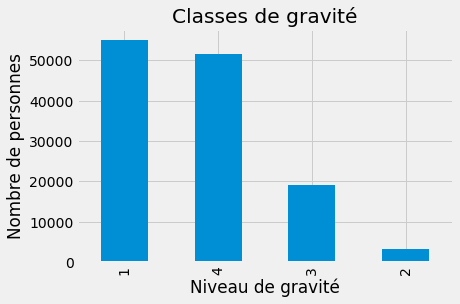

In [29]:
# On représente le nombre de personnes ayant subi chaque niveau de gravité de 1 = indemne, à 4 = blessé léger.
df.grav.value_counts().plot(kind='bar',xlabel='Niveau de gravité',ylabel='Nombre de personnes').set(title = "Classes de gravité")

On remarque que notre dataset est très déséquilibré dans la mesure où on a peu d'accidents de gravité 3 (blessé hospitalisé), très peu d'accidents de gravité 2 (tués) et beaucoup d'accidents moins graves, de classe 1 et 4 (indemne et blessé léger). Il faudra prendre cela en compte lors de notre modélisation. 

## Data visualisation et statistiques descriptives 

### Généralités et nettoyage 

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129093 entries, 0 to 129152
Data columns (total 37 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   place    129093 non-null  int64  
 1   catu     129093 non-null  int64  
 2   grav     129093 non-null  int64  
 3   sexe     129093 non-null  int64  
 4   an_nais  126086 non-null  float64
 5   trajet   129093 non-null  int64  
 6   secu1    129093 non-null  int64  
 7   catv     129093 non-null  int64  
 8   obs      129093 non-null  int64  
 9   obsm     129093 non-null  int64  
 10  choc     129093 non-null  int64  
 11  manv     129093 non-null  int64  
 12  motor    129093 non-null  int64  
 13  catr     129093 non-null  int64  
 14  circ     129093 non-null  int64  
 15  nbv      129093 non-null  int64  
 16  vosp     129093 non-null  int64  
 17  prof     129093 non-null  int64  
 18  plan     129093 non-null  int64  
 19  surf     129093 non-null  int64  
 20  infra    129093 non-null  

Seule la colonne an_nais possède des valeurs manquantes (3007). Nous nous en occuperons plus tard lors de la modélisation.

In [31]:
df.describe()

,place,catu,grav,sexe,an_nais,trajet,secu1,catv,obs,obsm,...,jour,mois,an,lum,agg,int,atm,col,lat2,long2
count,129093.000000,129093.000000,129093.000000,129093.000000,126086.000000,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000,...,129093.000000,129093.000000,129093.0,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000,129093.000000
mean,2.035517,1.320319,2.521632,1.262532,1983.095427,3.164385,1.823623,12.556668,1.078440,1.602488,...,15.788757,6.897694,2021.0,1.835661,1.625100,2.075519,1.618941,3.744920,44.275578,2.485148
std,2.526144,0.603735,1.379854,0.577182,18.744457,2.788772,2.239116,13.273993,3.188514,1.231875,...,8.793912,3.287693,0.0,1.436492,0.484099,2.008508,1.697275,1.847788,12.254404,19.191624
min,1.000000,1.000000,1.000000,-1.000000,1912.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,1.000000,1.000000,2021.0,1.000000,1.000000,1.000000,-1.000000,-1.000000,-23.395090,-178.085795
25%,1.000000,1.000000,1.000000,1.000000,1970.000000,0.000000,1.000000,7.000000,0.000000,1.000000,...,8.000000,4.000000,2021.0,1.000000,1.000000,1.000000,1.000000,2.000000,44.557749,1.360090
50%,1.000000,1.000000,3.000000,1.000000,1987.000000,4.000000,1.000000,7.000000,0.000000,2.000000,...,16.000000,7.000000,2021.0,1.000000,2.000000,1.000000,1.000000,3.000000,47.748534,2.399328
75%,1.000000,1.000000,4.000000,2.000000,1998.000000,5.000000,2.000000,10.000000,0.000000,2.000000,...,23.000000,10.000000,2021.0,2.000000,2.000000,2.000000,1.000000,6.000000,48.858018,4.831950
max,10.000000,3.000000,4.000000,2.000000,2021.000000,9.000000,9.000000,99.000000,17.000000,9.000000,...,31.000000,12.000000,2021.0,5.000000,2.000000,9.000000,9.000000,7.000000,51.057332,168.106549


On peut voir qu'une personne agée de 109 ans et un bébé de moins d'un an ont été impliqués dans des accidents en 2021 (en regardant le max et min de la colonne an_naiss).

In [32]:
df.loc[df['an_nais'] == 1912]

,place,catu,grav,sexe,an_nais,trajet,secu1,catv,obs,obsm,...,lum,dep,com,agg,int,atm,col,adr,lat2,long2
4459,2,2,3,2,1912.0,0,1,7,0,2,...,5,33,33167,2,1,1,2,Boulevard de l'Entre-Deux-Mers,44.84361,-0.51876


Cette personne de 109 ans a donc été hospitalisée. Elle était sur le siège passager lors de l'accident, sur une route limitée à 50 km/h, en pleine nuit avec éclairage public allumé.  

Nous remarquons aussi que la vitesse maximale est de 901 km/h. Nous pensons à une erreur de frappe, nous corrigeons donc cela en 90 km/h. Plus généralement, nous regardons la distribution des valeurs de vitesse. Nous changeons 300 en 30, de 500 à 520 en 50 et 700 et 770 en 70.

In [33]:
np.unique(df['vma'], return_counts = True)

(array([ -1,   1,   2,   3,   5,   6,   8,   9,  10,  12,  15,  20,  25,
         30,  40,  45,  50,  55,  60,  70,  75,  80,  90, 100, 110, 130,
        140, 180, 300, 500, 501, 502, 520, 700, 770, 900, 901]),
 array([ 1870,    34,    16,     2,    44,     7,     2,     3,   239,
            3,    51,   311,    41, 13542,   106,    35, 66260,     1,
          182,  9743,     3, 17019, 11034,    31,  5358,  3107,     2,
            2,     2,    14,     2,     3,     3,     3,     2,    11,
            5]))

In [34]:
abus = [300,500,501,502,520,700,770,900,901]

In [35]:
# On crée une boucle qui va changer les valeurs de la liste abus en valeurs plus plausibles 
# (il y avait sûrement des fautes de frappe)

for i in range(len(abus)):
    e = abus[i]
    # on ne garde que le chiffre des unités 
    chiffre = e//100
    # on rajoute 0 en chiffre des unités et l'ancien chiffre des unités devient celui des dizaines
    new_vma = float(str(chiffre)+str(0))
    # on note les indices des lignes où la valeur est un abus (valeur fausse)
    req_Index = list(np.where(df["vma"] == e))
    # on remplace ces abus par les nouvelles valeurs exactes
    for j in req_Index[0]:
        df.iloc[j,22] = new_vma

In [36]:
np.unique(df['vma'], return_counts = True)

(array([ -1,   1,   2,   3,   5,   6,   8,   9,  10,  12,  15,  20,  25,
         30,  40,  45,  50,  55,  60,  70,  75,  80,  90, 100, 110, 130,
        140, 180]),
 array([ 1870,    34,    16,     2,    44,     7,     2,     3,   239,
            3,    51,   311,    41, 13544,   106,    35, 66282,     1,
          182,  9748,     3, 17019, 11050,    31,  5358,  3107,     2,
            2]))

Enfin, on sait que la longitude de la France métropolitaine est entre -4° et 8° et sa latitude entre 42° et 51°. Alors, étant donné les min et max de lat2 et long2, on comprend que la base de données ne se restreint donc pas seulement à la France métropolitaine : elle comprend aussi l'Outre-Mer français.

### Gravité de l'accident en fonction de l'âge 

In [37]:
def cat(annee):
    if annee >= 1996:
        return "moins de 25 ans"
    elif annee > 1961:
        return "entre 25 et 60 ans"
    else :
        return "plus de 60 ans"

In [38]:
# On travaille sur une copie de df pour ne pas modifier le df de base par erreur. 
df3 = df.copy()

# On applique la fonction cat pour créer une nouvelle colonne catégorie_age.
df3['category_age'] = df['an_nais'].apply(cat)

[Text(0.5, 1.0, "Distribution de la gravité en fonction de l'âge")]

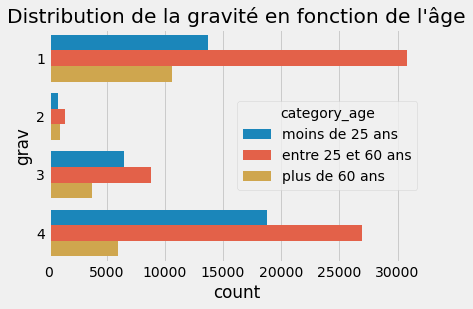

In [39]:
sns.countplot(y='grav',data=df3, hue ='category_age').set(title="Distribution de la gravité en fonction de l'âge")

La catégorie avec le plus de conducteurs actifs est donc la plus représentée dans chacune des classes de gravité.

En effet, on constate que les personnes possédant entre 25 et 60 ans sont ceux qui réalisent le plus d'accidents dans chaque classe de gravité. Ceci est logique dans la mesure où ils sont aussi ceux qui sont les plus actifs en conduite. 

### Géographie et accidents 

#### Villes 

On cherche à représenter graphiquement nos données afin de mieux s'approprier les variables et déterminer lesquels serontn utiles ou non à notre prédiction de modèle ensuite. 

On observe ici la distribution du nombre d'accidents en fonction des départements/villes, et en France afin de visualiser grahiquement et ainsi plus facilement ces données. 

In [40]:
df3 = df.copy()

In [41]:
communes = df3.com.unique()
len(communes)

11150

Les accidents reportés dans cette base de données ne se sont produits que dans moins de 12000 communes, sur plus de 36000 en France selon l'INSEE.

[Text(0.5, 1.0, "Distribution du nombre d'accidents en fonction du département")]

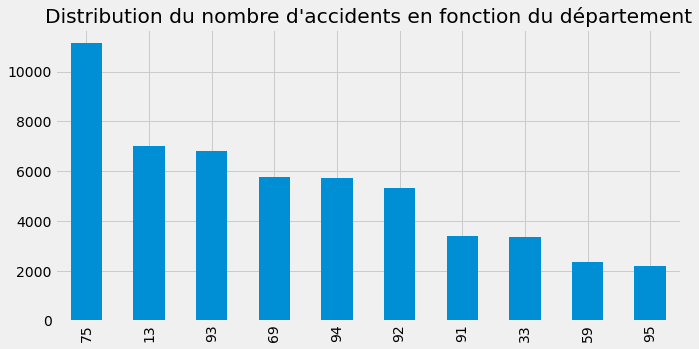

In [42]:
plt.figure(figsize=(10,5))
df3.dep.value_counts().sort_values(ascending=False)[:10].plot(kind='bar').set(title = "Distribution du nombre d'accidents en fonction du département")

Sans surprise, la ville de Paris contient le plus grand nombre d'accidents routiers. Cela n'implique pas directement que conduire à Paris augmente la probabilité d'avoir un accident dans la mesure où il faut prendre en compte le nombre de voitures circulant dans la capitale.

On peut chercher, pour se faire une idée, à savoir quel arrondissement de Paris, ville où il y a le plus d'accidents, comporte le plus d'accidents. 

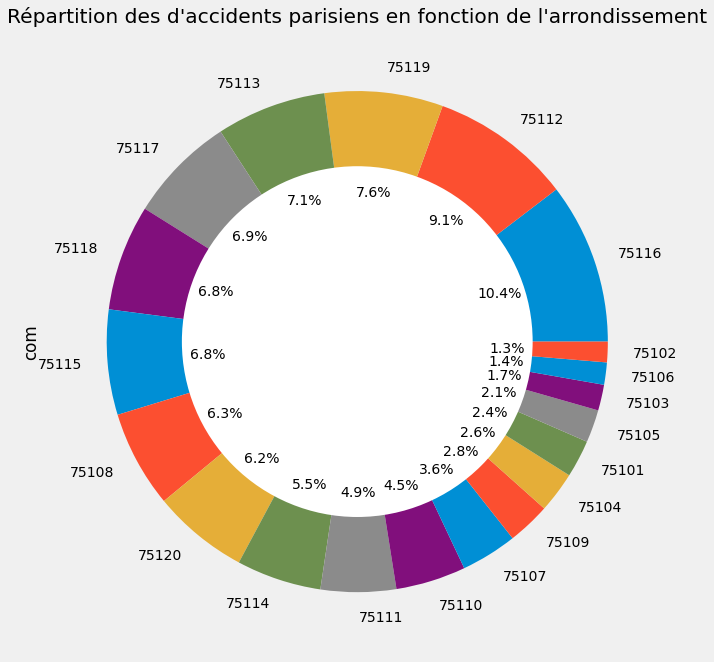

In [43]:
paris =df3[df3['dep']=='75']
plt.figure(figsize=(10,15))
paris.com.value_counts().plot(kind='pie',autopct='%1.1f%%').set(title = "Répartition des d'accidents parisiens en fonction de l'arrondissement")

centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)
  

Le 16e arrondissement de Paris est celui qui comporte le plus d'accidents de la route avec 10.4% des accidents de Paris dans cet arrondissement. 

#### Cartes interactives 

Les cartes interactives vont nous permettre de visualiser la distribution des accidents en fonction des départements (et constater que les accidents concernent aussi l'outremer français). 

Pour ce faire, on trace tout d'abord une carte interactive représentant un échantillon des accidents routiers en France en 2021. 

In [44]:
df_sample = df.sample(int(len(df)*0.01))
df_sample

,place,catu,grav,sexe,an_nais,trajet,secu1,catv,obs,obsm,...,lum,dep,com,agg,int,atm,col,adr,lat2,long2
21719,1,1,1,1,1962.0,0,2,2,0,2,...,1,974,97416,2,4,1,3,DIAGONALE(CHEMIN),-21.292190,55.470680
11510,2,2,4,1,2001.0,4,1,10,0,2,...,1,93,93066,2,1,8,3,FORT DE LA BRICHE (CHEMIN),48.944280,2.342270
110835,1,1,1,1,1951.0,5,1,7,0,1,...,1,63,63113,2,1,1,6,MONTLOSIER (RUE),45.781378,3.088096
53326,1,1,1,-1,NaN,-1,-1,7,0,2,...,5,976,97611,2,1,1,3,mamoudzou centre-Adrian SOULI (avenue),-12.779710,45.232740
51470,2,2,1,1,1998.0,5,1,7,0,2,...,1,06,06069,2,1,1,2,PEGOMAS (ROUTE DE),43.641530,6.936750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96155,1,1,1,1,1950.0,0,1,10,0,1,...,1,38,38185,2,1,1,6,Rue Charles Péguy,45.178770,5.715640
18006,2,2,1,1,2001.0,0,1,7,0,9,...,2,35,35238,2,1,1,3,LECLERC (AVENUE DU GENERAL),48.114690,-1.656400
9111,1,1,4,1,1989.0,1,1,7,0,2,...,3,67,67281,1,1,1,1,Route d Artzenheim,48.152817,7.543412
101891,1,1,1,2,1950.0,9,1,7,0,1,...,1,91,91272,2,6,9,1,Route de la Croix de Fer,48.703376,2.126155


In [45]:
import folium

palette = sns.color_palette("coolwarm", 8)

def interactive_map(df):

    # On convertit en nombre les couleurs 
    df_sample['color'] = [int(df_sample.iloc[i]['grav']) for i in range(len(df_sample))]

    df_sample['color'] = [palette.as_hex()[x] for x in df_sample['color']]


    center = df_sample[['lat2', 'long2']].mean().values.tolist()
    sw = df_sample[['lat2', 'long2']].min().values.tolist()
    ne = df_sample[['lat2', 'long2']].max().values.tolist()
    
    # On trace la carte du monde 
    m = folium.Map(location = center, tiles='Stamen Toner')

    # On rajoute des marker "voiture" un à un sur la carte
    for i in range(0,len(df)):
        
        #On affiche sur cette carte la valeur de la luminosité lors de l'accident, la vitesse maximale autorisée sur la route correspondante
        # et la gravité de l'accident.
        folium.Marker([df_sample.iloc[i]['lat2'], df_sample.iloc[i]['long2']],
                    popup=f"Luminosité: {df_sample.iloc[i]['lum']}, <br>gravité: {df_sample.iloc[i]['grav']}, <br>vma: {df_sample.iloc[i]['vma']}",
                    icon=folium.Icon(icon='car', prefix='fa')).add_to(m)

    m.fit_bounds([sw, ne])

    return m

m = interactive_map(df_sample)

In [46]:
m

On va à présent réaliser une carte représentant la répartition des accidents en rance selon le département afin de visualiser rapidement les lieux où il y a le plus d'accident. 

In [47]:
pip install geojson

Note: you may need to restart the kernel to use updated packages.


In [48]:
# On utilise les modules geopandas, json et geojson eton ouvre le fichier téléchargé. 

import geopandas as gpd
import json
import geojson
departements = gpd.read_file(PATH_GEO_JSON)
departements.head()

,code,nom,geometry
0,01,Ain,"POLYGON ((4.78021 46.17668, 4.78024 46.18905, ..."
1,02,Aisne,"POLYGON ((3.17296 50.01131, 3.17382 50.01186, ..."
2,03,Allier,"POLYGON ((3.03207 46.79491, 3.03424 46.79080, ..."
3,04,Alpes-de-Haute-Provence,"POLYGON ((5.67604 44.19143, 5.67817 44.19051, ..."
4,05,Hautes-Alpes,"POLYGON ((6.26057 45.12685, 6.26417 45.12641, ..."


In [49]:
dep_accident = df3.dep.value_counts().to_frame().reset_index()

# On crée une échelle d'incidence des accidents de la route en focntion du département. 

dep_accident["échelle d'incidence"]=np.log10(dep_accident['dep'])
dep_accident

,index,dep,échelle d'incidence
0,75,11157,4.047547
1,13,7029,3.846894
2,93,6802,3.832637
3,69,5768,3.761025
4,94,5722,3.757548
...,...,...,...
102,90,98,1.991226
103,978,87,1.939519
104,977,42,1.623249
105,986,23,1.361728


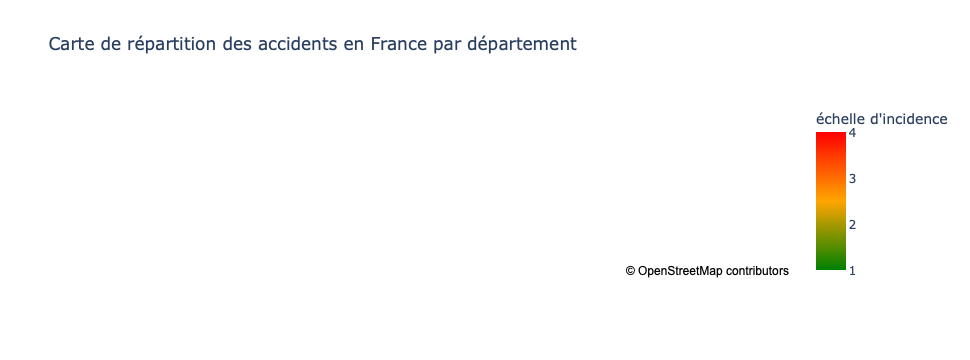

In [50]:
import plotly.express as px

#On trace et affiche la carte 

fig1 = px.choropleth_mapbox(dep_accident, locations = 'index',
                            geojson= departements,
                            color="échelle d'incidence",
                            color_continuous_scale=["green","orange","red"],
                            range_color=[1,4],
                            hover_name='index',
                            hover_data=['dep'],
                            title="Carte de répartition des accidents en France par département",
                            mapbox_style="open-street-map",
                            center= {'lat':46, 'lon':2},
                            zoom =3.5, 
                            opacity= 0.6)

fig1.show()

On constate effectivement que les incidences d'accidents ont surtout lieu dans les endroits très peuplés comme en Région Ile-de-France ou près de Lyon. 

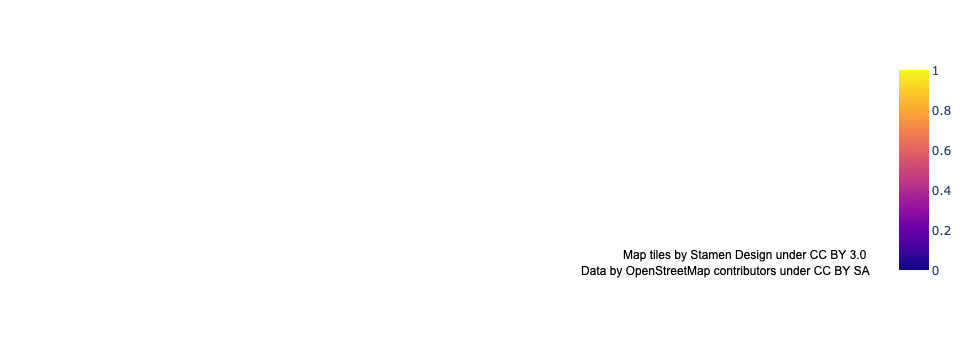

In [51]:
df_samp = df.sample(int(len(df)*0.01))

df_samp 
fig2 = px.density_mapbox(df_samp, lat='lat2',lon='long2', radius=10, center=dict(lat=48.9, lon=2.4), zoom=4,
                         mapbox_style="stamen-watercolor")
fig2.show()

On peut aussi visualiser l'occurence des accidents routiers en France sur un échantillon d'accidents de 2021 à l'aide de cette sensity mapbox qui nousn permet en plus d'accéder aux valeurs de latitute et longitude correspondantes contrairement à la carte précédente. On retrouve aussi beaucoup d'accidents en Ile-de-France par exemple. Les points d'une certaine couleur permettent de visualiser l'intensité du nombre d'occurences de l'accident facilement. 

### Occurence des accidents en fonction de Heures, Jours et Mois 

#### Heures d'accident

In [52]:
df2.hrmn = pd.to_datetime(df2.hrmn)
#df2.hrmn.dt.hour

[Text(0.5, 1.0, "Distribution du nombre d'accidents en fonction de l'heure")]

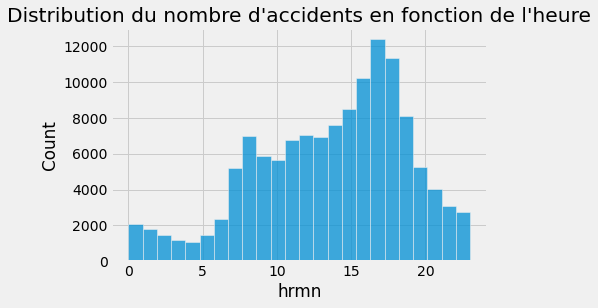

In [53]:
sns.histplot(df2.hrmn.dt.hour,bins=24).set(title = "Distribution du nombre d'accidents en fonction de l'heure")

On observe la distribution du nombre d'accidents en fonction de l'heure de la journée. 

On observe d'un pic d'accidents vers 17h, ce qui est logique car cet horaire correspond à l'heure de pointe où il y a plus de monde sur les routes donc plus d'accidents. 

#### Jours et mois d'accident

[Text(0.5, 1.0, "Distribution du nombre d'accidents en fonction du jour")]

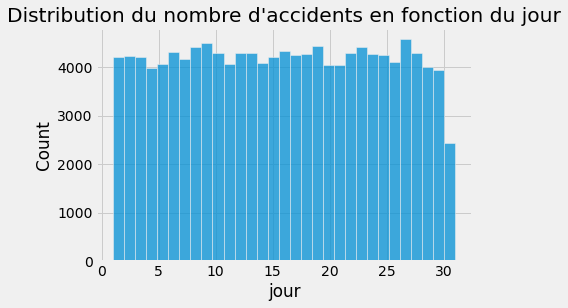

In [54]:
sns.histplot(df.jour,bins = 31).set(title = "Distribution du nombre d'accidents en fonction du jour")

[Text(0.5, 1.0, "Distribution du nombre d'accidents en fonction du mois")]

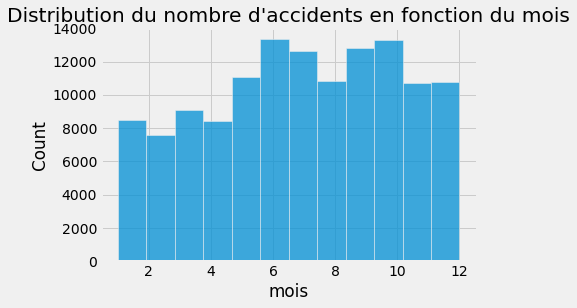

In [55]:
sns.histplot(df.mois,bins = 12).set(title = "Distribution du nombre d'accidents en fonction du mois")

Ainsi, on comprend déjà que ces variables jours, mois, heures peuvent être utiles pour prédire la gravité d'un accident de la route mais on ne les utilisera pas dans la suite car ce ne sont pas les plus principales. Plus il y a de monde sur les routes (en fonction de l'heure de pointe, ou d'un mois ou jour de la semaine où les gens travaillent et ne sont pas en vacances ou en week-end), plus il y a d'accidents. 

### Gravité de l'accident en fonction de la luminosité 

[Text(0.5, 1.0, 'Distribution de la luminosité en fonction de la gravité')]

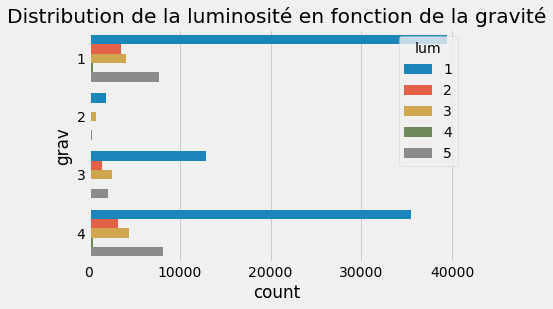

In [56]:
sns.countplot(y='grav',data=df,hue='lum').set(title = "Distribution de la luminosité en fonction de la gravité")

Luminosité = 1 correspond au plein jour. Quelque soit la gravité, il y a beaucoup plus d'accidents le jour dû au nombre de voitures. Pour la gravité = 2 qui correspond à tué, on remarque que cela s'équilibre plus avec lum = 3 qui correspond à la nuit sans éclairage public. Cela semble cohérent : les conditions de circulation sont plus dangereuses.

### Gravité de l'accident en fonction du sexe de l'usager

[Text(0.5, 1.0, 'distribution du sexe en fonction de la gravité')]

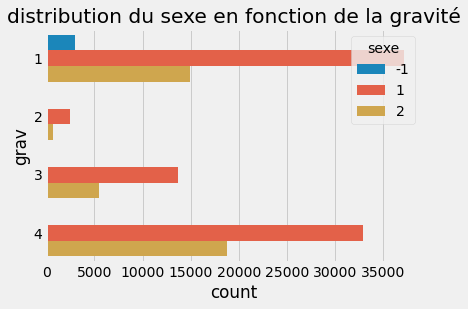

In [57]:
sns.countplot(y='grav',data=df,hue='sexe').set(title = "distribution du sexe en fonction de la gravité")

Quelque soit la gravité, il y a beaucoup plus d'hommes (=1) impliqués dans des accidents de voiture que de femmes (=2). Ce critère peut sembler utile pour la suite en tant que features. 

### Gravité de l'accident en fonction de la vitesse maximale autorisée (vma)

In [58]:
def vitesse(speed):
    if speed < 50 : 
        return " moins de 50 km/h"
    elif speed < 80 :
        return "entre 50 et 80 km/h"
    elif speed < 130:
        return "entre 80 et 130 km/h"
    else:
        return "plus de 130 km/h"

In [59]:
dfvitesse = df.copy()
dfvitesse['category_speed'] = df['vma'].apply(vitesse)

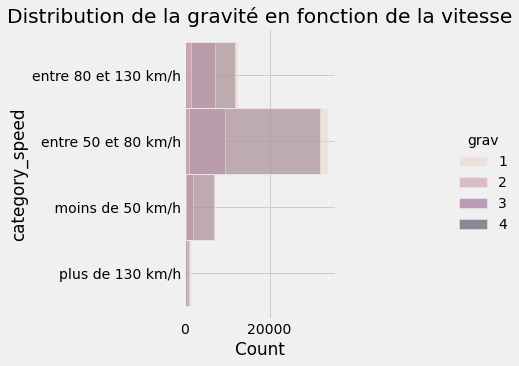

In [60]:
sns.displot(y='category_speed',data=dfvitesse,hue='grav').set(title="Distribution de la gravité en fonction de la vitesse")

La grande majorité des accidents ont lieu entre 50 et 80 km/h. Cependant, les accidents les plus mortels se plus produisent à haute vitesse. Cette variable sera sûrement utile pour la suite pour prédire la gravité d'un accident routier. 

### Gravité de l'accident en fonction de la place dans le véhicule

On constate, comme on pouvait le penser, que la gravité d'un accident est lié à sa place dans le véhicule : un accident grave (tué) arrive plus pour le conducteur du véhicule (correspondant à 1), suivi du passager à ses côtés (place du mort (correspondant à 2)), il est en général moins grave pour les passagers sur les places de derrière de la voiture (correspondant à 3 et 4) et pour les piétons (correspondant à 10). 

[Text(0.5, 1.0, 'Distribution de la gravité en fonction de la place')]

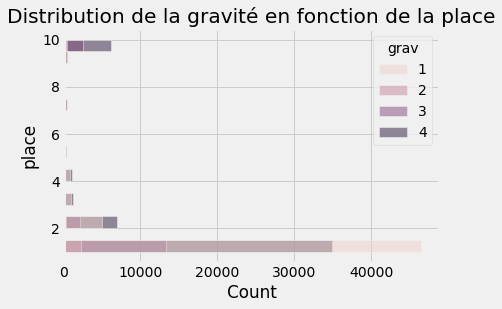

In [61]:
sns.histplot(y='place',data=df,hue='grav').set(title="Distribution de la gravité en fonction de la place")

### Gravité de l'accident en fonction de l'obstacle mobile heurté

[Text(0.5, 1.0, 'Histogramme des obstacles mobiles heurtés')]

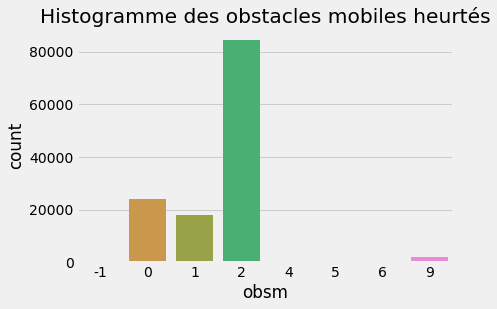

In [62]:
sns.countplot(x='obsm', data=df).set(title="Histogramme des obstacles mobiles heurtés")

[Text(0.5, 1.0, "Distribution de la gravité en fonction d'obstacle mobile heurté")]

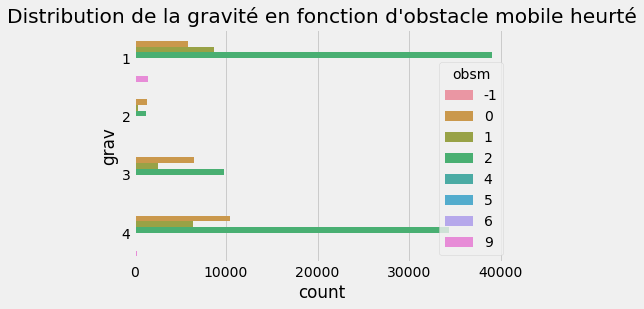

In [63]:
sns.countplot(y='grav',data=df,hue='obsm').set(title="Distribution de la gravité en fonction d'obstacle mobile heurté")

On constate que, pour toutes les classes de gravité d'accident, l'accident a surtout eu lieu en touchant un autre véhicule, plus qu'un piéton ou qu'aucun obstacle. Cette variable semble être une feature qui peut permettre de déterminer la gravité d'un accident. 

### Types de collisions

In [64]:
# On travaille sur une copie de df pour ne pas modifier le df de base par erreur. 
df3 = df.copy()

In [65]:
def cat2(col):
    if  3>=col>=1:
        return "2 véhicules"
    elif 5>=col>=4:
        return "3 véh et plus"
    elif col==6:
        return "Autre"
    else :
        return "Sans"

In [66]:
# On applique la fonction cat pour créer une nouvelle colonne catégorie_age.
df3['category_col'] = df['col'].apply(cat2)

[Text(0.5, 1.0, 'Histogramme des différents types de collisions')]

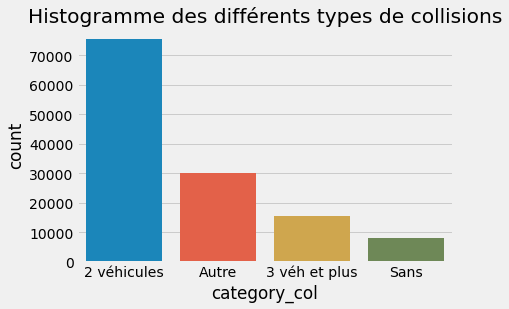

In [67]:
sns.countplot(x='category_col', data=df3).set(title="Histogramme des différents types de collisions")

On remarque que le type de collision principale correspond à la collision entre deux véhicules. Cette variable ne sera donc peut-être pas très utile pour notre modèle pour aider dans la prédiction de la gravité d'un accident.

### Types de chocs

In [68]:
# On travaille sur une copie de df pour ne pas modifier le df de base par erreur. 
df3 = df.copy()

In [69]:
def cat3(choc):
    if  3>=choc>=1:
        return "Avant"
    elif 6>=choc>=4:
        return "Arrière"
    elif choc==7:
        return "Droite"
    elif choc==8:
        return "Gauche"
    else :
        return "Multiples"

In [70]:
# On applique la fonction cat pour créer une nouvelle colonne catégorie_age.
df3['category_choc'] = df['choc'].apply(cat3)

[Text(0.5, 1.0, 'Histogramme des différents types de chocs')]

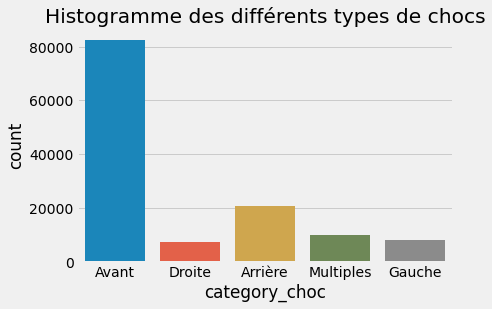

In [71]:
sns.countplot(x='category_choc', data=df3).set(title="Histogramme des différents types de chocs")

La majorité des points de choc initiaux ont lieu à l'avant du véhicule. 

### Types d'intersection 

[Text(0.5, 1.0, 'Histogramme des intersections')]

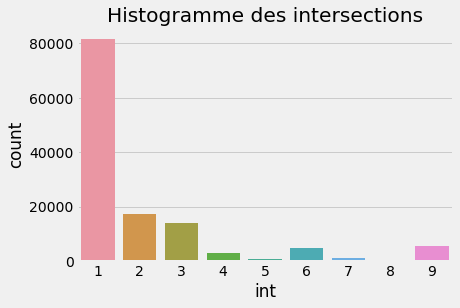

In [72]:
sns.countplot(x='int', data=df).set(title="Histogramme des intersections")

On remarque que la majorité des accidents a lieu hors intersection (int = 1) car cela correspond à plus de 80 000 accidents. Les intersections en X et en T (int = 2 et 3) sont aussi responsables de beaucoup d'accidents. 

## DATA SELECTION

In [73]:
df.var().sort_values()

/var/folders/1c/nkg3ybs11lj6wgwvnb16pdl80000gn/T/ipykernel_66648/354554810.py:1: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



an           0.000000
agg          0.234352
prof         0.291959
sexe         0.333139
catu         0.364496
plan         0.442230
vosp         0.447147
surf         0.653306
circ         0.829412
motor        0.937469
obsm         1.517517
catr         1.886918
grav         1.903997
nbv          2.023170
lum          2.063509
situ         2.116017
atm          2.880744
col          3.414321
int          4.034106
infra        4.534668
secu1        5.013642
choc         5.730015
place        6.381404
trajet       7.777249
obs         10.166623
mois        10.808926
manv        66.187785
jour        77.332890
lat2       150.170406
catv       176.198902
an_nais    351.354656
long2      368.318417
vma        572.116788
dtype: float64

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

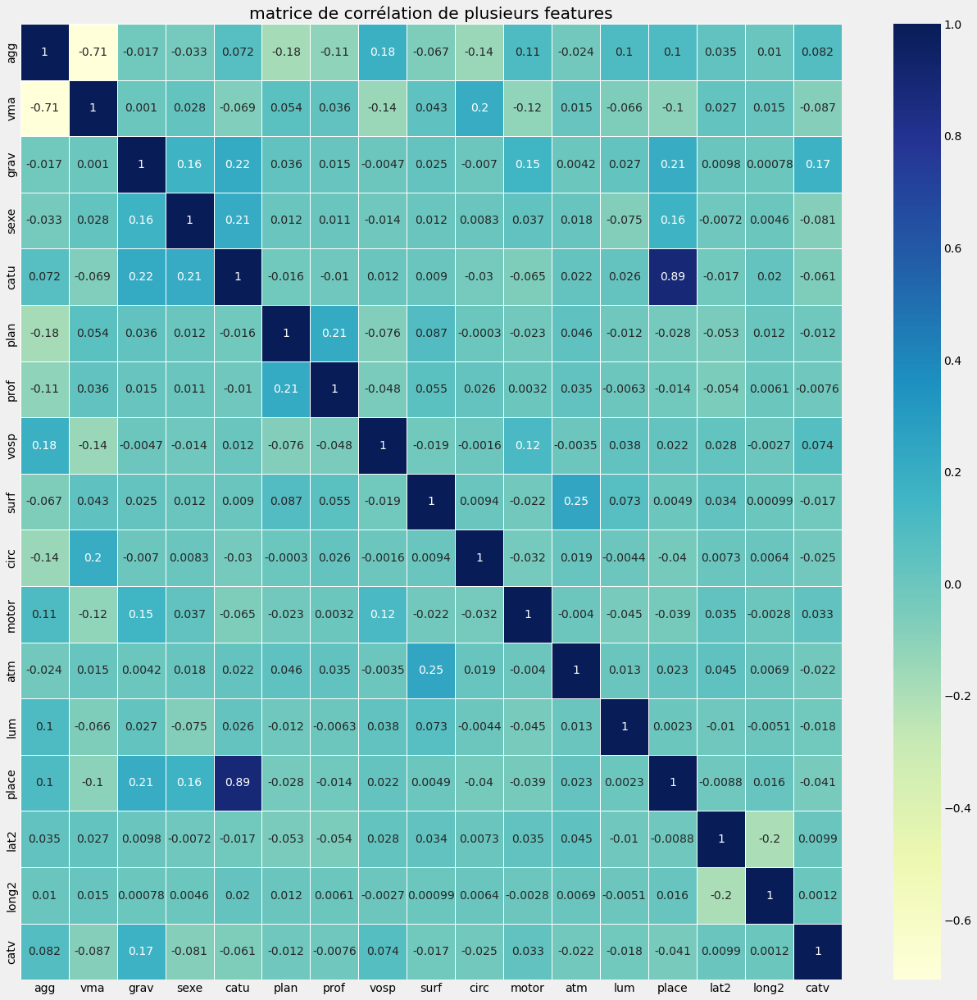

In [74]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['agg','vma','grav','sexe', 'catu', 'plan','prof', 'vosp', 'surf',
                'circ','motor','atm','lum','place','lat2','long2',
                'catv']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

Les colonnes prof, catu, plan, vosp et circ correspondant respectivement au profil en long décrivant la déclivité de la route à l'endroit de l'accident, la catégorie d'usager, le tracé en plan, l’existence d’une voie réservée, indépendamment du fait que l’accident ait lieu ou non sur cette voie, le régime de circulation ont des variances très faibles, entre 0.1 et 1, pour des variables catégorielles non binaires, donc on peut les retirer des features aidant à la prédiction de notre modèle. 

De plus, la heatmap montre que 'catu' et 'place' ont une corrélation de 0.89 donc on peut garder uniquement 'place' en feature. De même, 'surf' et 'atm' sont corrélés à 0.25 donc on ne peut en garder qu'un seul en feature. Aussi, 'agg' et 'vma'(vitesse maximale autorisée sur la portion de route correspondante) sont très corrélés négativement (-0.64) donc on peut ne garder que 'vma' en feature. De plus, 'vosp' est corrélé à 'agg' corrélé à 'vma' donc on peut les enlever aussi. 'Circ' a une corrélation significative de 0.19 avec 'vma' donc on peut aussi le retirer du dataset pour la prédiction. 

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

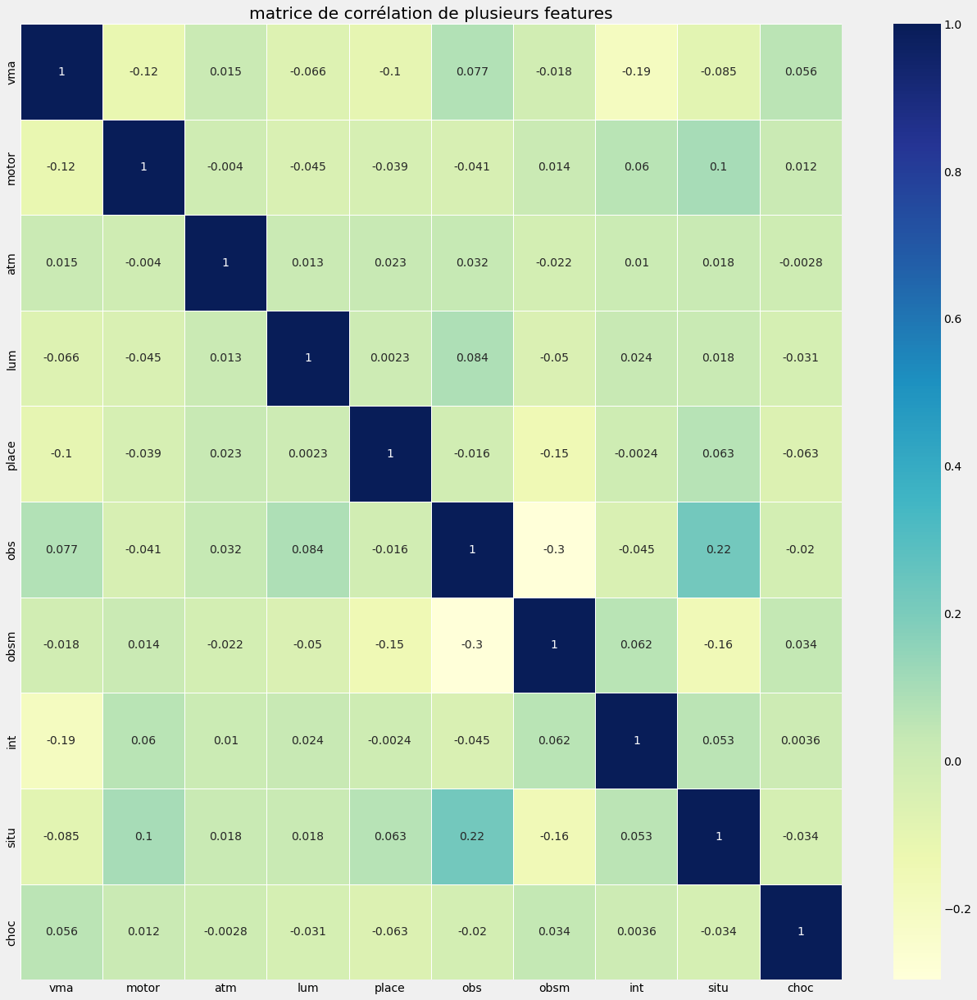

In [75]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['vma','motor','atm','lum','place','obs','obsm','int','situ',
                'choc']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

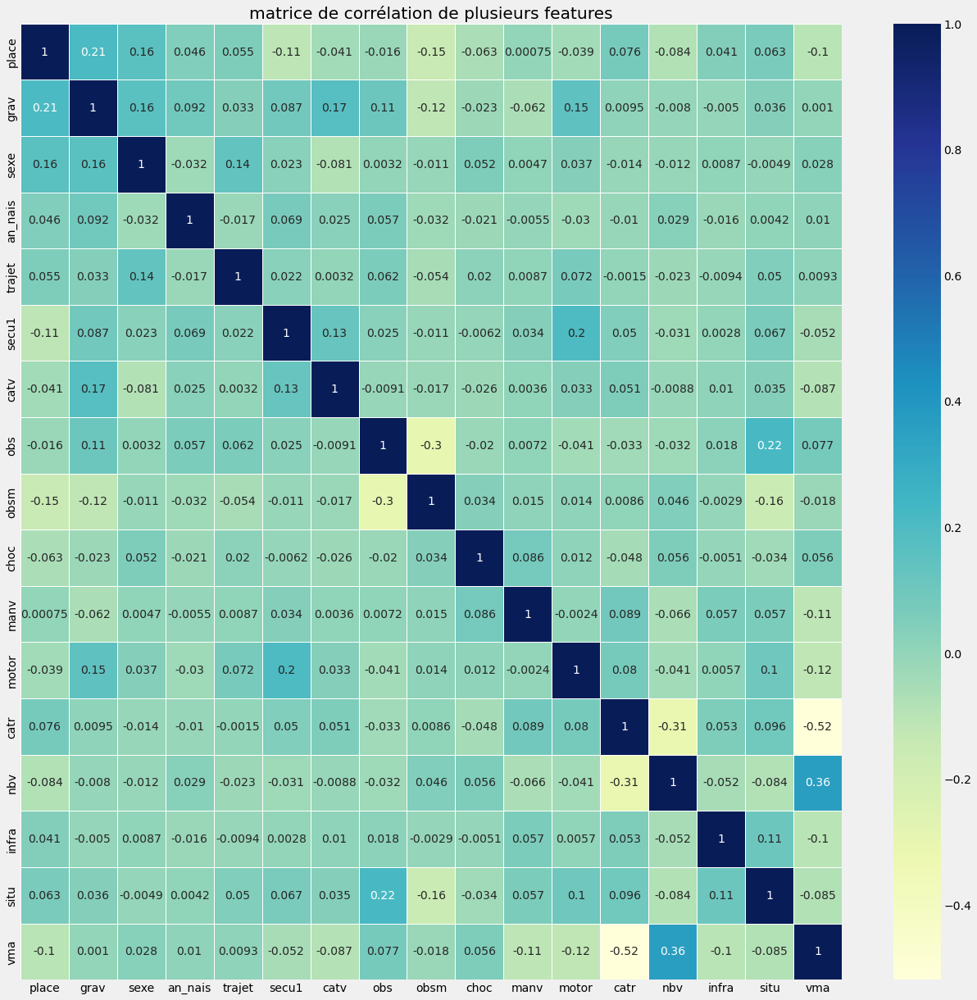

In [76]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['place','grav', 'sexe', 'an_nais', 'trajet', 'secu1',
       'catv', 'obs', 'obsm', 'choc', 'manv', 'motor', 'catr','nbv','infra','situ',
                'vma']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

'obs' et 'obsm' ont une corrélation de -0.3 ce qui est élevé donc on n'en garde qu'un seul en feature ('obsm'). 
'catr' et 'vma' ont une corrélation de -0.47 ce qui est élevé donc on n'en garde qu'un seul en feature ('vma').
'situ' et 'obsm' ont une corrélation de -0.16 ce qui est élevé donc on n'en garde qu'un seul en feature ('obsm').
'nbv' et 'vma' ont une corrélation de 0.33 ce qui est élevé donc on n'en garde qu'un seul en feature ('vma').

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

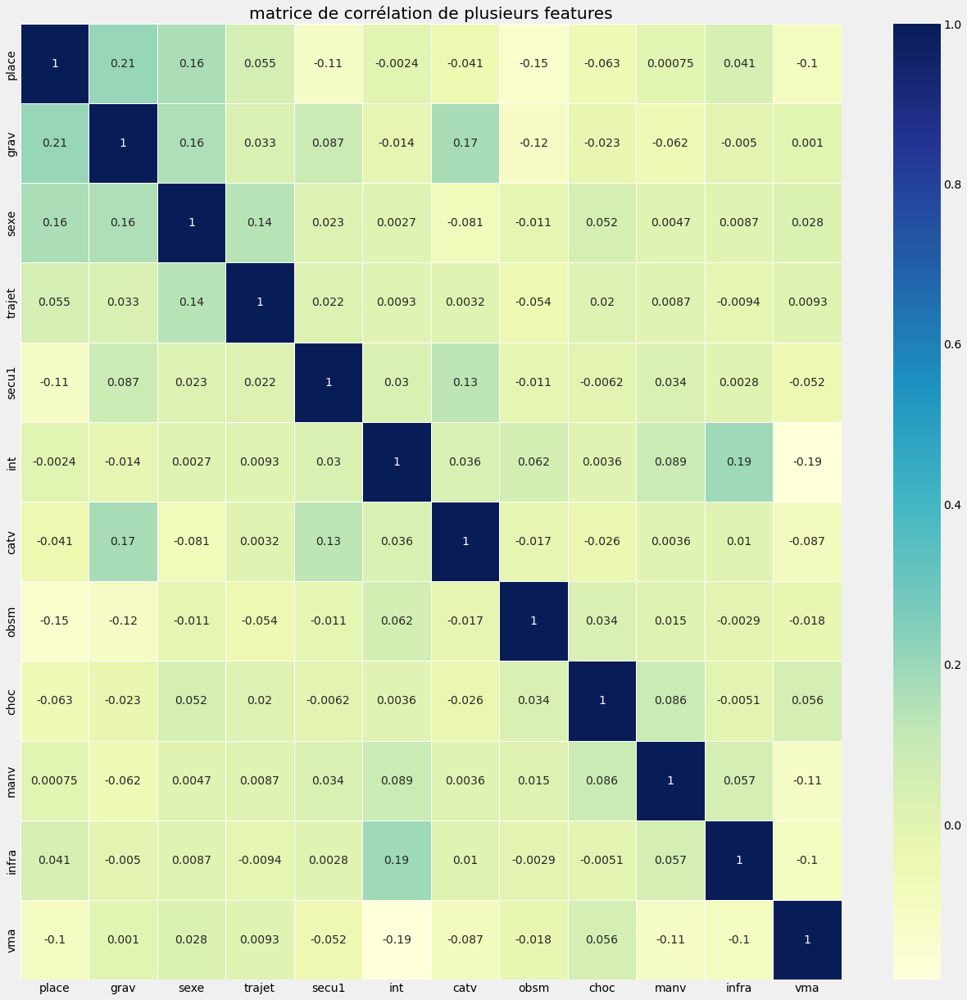

In [77]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['place','grav', 'sexe','trajet', 'secu1','int',
       'catv','obsm', 'choc', 'manv','infra','vma']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

'infra', 'trajet' et 'manv' peuvent être retirés car ils sont corrélés à d'autres variables utilisés déjà en feature et sont ainsi peu utiles. 

[Text(0.5, 1.0, 'matrice de corrélation de plusieurs features')]

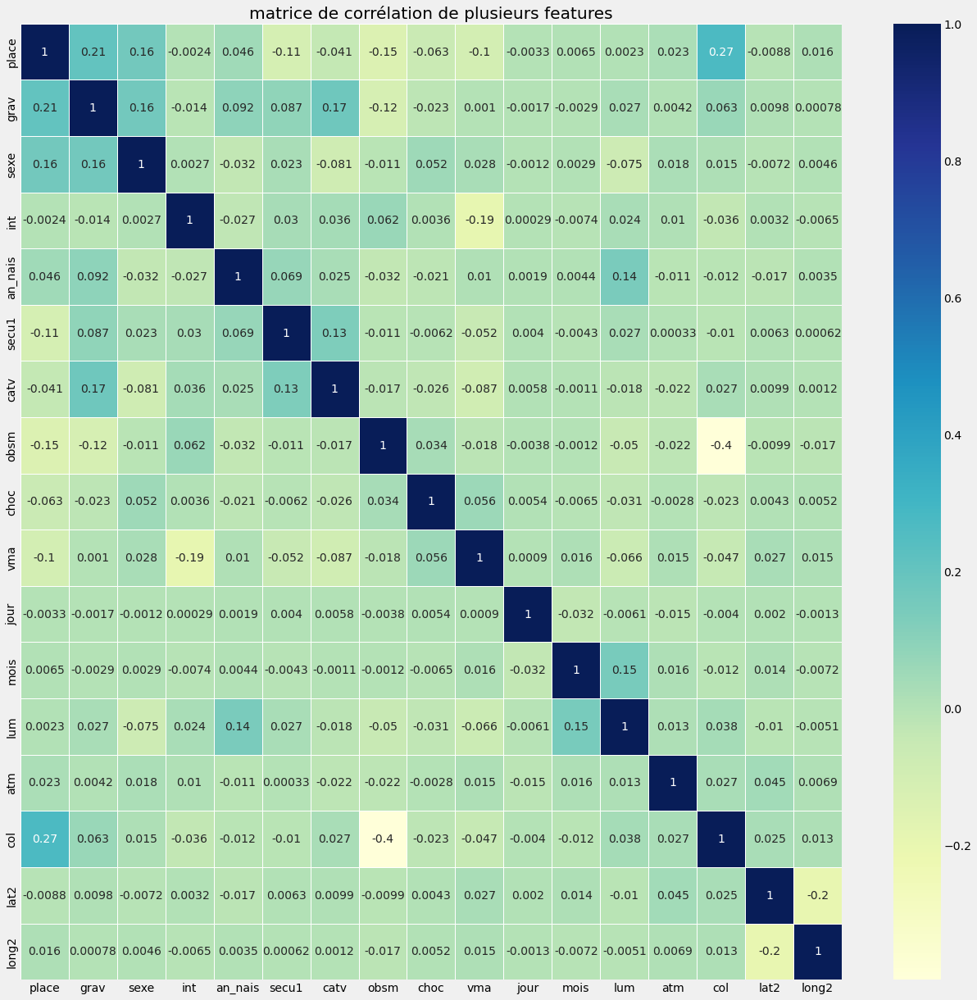

In [78]:
plt.figure(figsize=(20,20))
sns.heatmap(df[['place','grav','sexe','int','an_nais','secu1',
       'catv','obsm', 'choc', 'vma','jour', 'mois', 'hrmn', 'lum', 'dep', 'com', 'atm',
       'col', 'adr', 'lat2', 'long2']].corr(),annot=True,linewidth=.5,cmap='YlGnBu').set(title = "matrice de corrélation de plusieurs features")

'col' et 'obsm' ont une corrélation négative de -0.4 ce qui est élevé donc on n'en garde qu'un seul en feature ('obsm'). 
De plus, 'dep' et 'com' ne sont pas utiles puisqu'on dispose de la latitude et de la longitude. 
Les variables 'jour' et 'mois' ne seront pas utiles pour la prédiction, n'influant pas sur la gravité d'un accident.

On supprime directement la colonne an : nous n'avons que des données de 2021.

Grâce à ce processus de data sélection et de statistiques descriptives, on peut supprimer les colonnes inutiles, c'est-à-dire celles qui ne serviront pas de features pour notre modèle. 

In [79]:
df.drop(['trajet','catu',
       'obs', 'catr', 'circ', 'nbv', 'vosp',
       'prof', 'plan', 'surf', 'infra', 'situ', 'jour', 'mois', 'an',
       'hrmn', 'dep', 'com', 'agg', 'col', 'adr'], axis = 1, inplace = True)

## MODELISATION

### Preprocessing 

In [80]:
dfmodel = df.copy()

Après notre processus de data sélection, on n'a don conservé que 16 colonnes : 1 target = 'grav' et 15 features qui nous serviront pour la prédiction. 

In [81]:
dfmodel.columns

Index(['place', 'grav', 'sexe', 'an_nais', 'secu1', 'catv', 'obsm', 'choc',
       'manv', 'motor', 'vma', 'lum', 'int', 'atm', 'lat2', 'long2'],
      dtype='object')

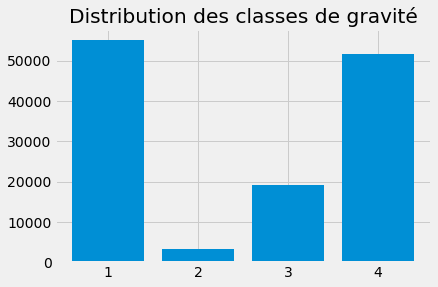

In [82]:
labels, counts = np.unique(dfmodel['grav'], return_counts=True)
plt.bar(labels, counts)
plt.gca().set_xticks(labels)
plt.title('Distribution des classes de gravité')
plt.show()

On rappelle que les classes sont  : 1 = indemne, 2 = tué, 3 = hospitalisé, 4 = bléssé léger.
On remarque un fort déséquilibrage des classes visées pour la prédiction. En premier lieu, nous regroupons les tués et hospitalisés en une seule classe, car ils correspondent à une gravité élevée et permettent de rééquilibrer un peu les classes. 

In [83]:
dfmodel['grav'] =  dfmodel['grav'].apply(lambda x: 2 if x == 3 else x) # fusion des classes 2 et 3.
dfmodel['grav'] =  dfmodel['grav'].apply(lambda x: 3 if x == 4 else x) # classe 4 devient la nouvelle classe 3
dfmodel['grav'] =  dfmodel['grav'].apply(lambda x: x-1) # première classe doit être 0

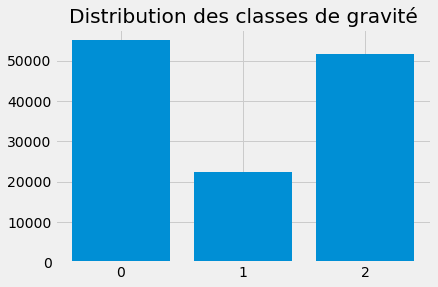

In [84]:
labels2, counts2 = np.unique(dfmodel['grav'], return_counts=True)
plt.bar(labels2, counts2)
plt.gca().set_xticks(labels2)
plt.title('Distribution des classes de gravité')
plt.show()

Nous voulons ré-équilibrer les classes de gravité pour éviter un biais de prédiction. Pour cela, nous utilisons un algorithme d'over sampling, SMOTENC, qui gère aussi bien les données numériques que catégorielles.

In [85]:
Y = dfmodel['grav'] # Y est la target qu'on cherche à prédire 
X = dfmodel.drop(['grav'],axis = 1) # 'grav' est la target donc on l'enlève de X qui correspond aux features

In [86]:
X.isnull().sum()

place         0
sexe          0
an_nais    3007
secu1         0
catv          0
obsm          0
choc          0
manv          0
motor         0
vma           0
lum           0
int           0
atm           0
lat2          0
long2         0
dtype: int64

In [87]:
X['an_nais'].mean(),X['an_nais'].median()

(1983.095426930825, 1987.0)

On choisit de compléter les 3007 valeurs manquantes d'années de naissance par la médiane des années de naissance car elle est moins sensible aux valeurs aberrantes que la moyenne. 

In [88]:
median = X['an_nais'].median()
X['an_nais'].fillna(median, inplace=True)

Etant donné que nous avons un dataset déséquilibré avec beaucoup moins de valeurs de gravité égales à 1 (fusion des blessés hospitalisés et ds tués) que de valeurs égales à 0 ou 2 (indemnes et blessés légers), nous allons utiliser une méthode pour rééquilibrer le dataset appelé SMOTE NC. Le SMOTE, acronyme pour Synthetic Minority Oversampling TEchnique, est une méthode de suréchantillonnage des observations minoritaires. Il consiste à générer de nouveaux individus minoritaires qui ressemblent aux autres, sans être strictement identiques. Cela permet de densifier de façon homogène la population d’individus minoritaires. Cependant, le SMOTE classique ne permet pas de traiter les variables catégorielles. Pour traiter des données mixtes (mixed data), c’est-à-dire contenant à la fois des variables numériques et catégorielles, il faut utiliser une variante : le SMOTE-NC, pour SMOTE-Nominal Continuous.

In [89]:
Xtrain, Xtest, Ytrain, Ytest = train_test_split(X,Y)

In [90]:
Ytrain.value_counts()

0    41426
2    38693
1    16700
Name: grav, dtype: int64

In [91]:
var_categoriques = [0,1,3,4,5,6,7,8,10,11,12] #indices des colonnes de features catégoriques
smNC = SMOTENC(categorical_features=var_categoriques)
XsmotedNC, YsmotedNC = smNC.fit_resample(Xtrain,Ytrain)

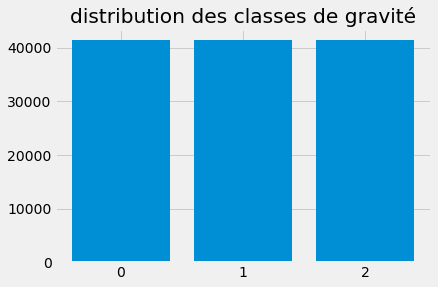

In [92]:
labels_reb, counts_reb = np.unique(YsmotedNC, return_counts=True)
plt.bar(labels_reb, counts_reb)
plt.gca().set_xticks(labels_reb)
plt.title('distribution des classes de gravité')
plt.show()

Nous avons bien ré-équilibré les classes comme nous le voulions, après avoir split le dataset. Ainsi, l'algorithme ne pourra plus prédire seulement la classe majoritaire afin d'assurer une bonne précision.

Nous devons maintenant encoder nos variables catégorielles (à l'aide du one hot encoding) et standardiser les variables continues. 

In [93]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
sc = StandardScaler()
enc = OneHotEncoder(handle_unknown='ignore')

In [94]:
var_cat = ['place','sexe','secu1','catv','obsm','choc','manv','motor','lum','int','atm'] # features catégoriques qu'on veut encoder
var_cont = ["an_nais","vma","lat2","long2"] # features numériques continus qu'on veut standardiser

In [95]:
XsmotedNC_cat = enc.fit_transform(XsmotedNC[var_cat])
Xtest_cat = enc.transform(Xtest[var_cat])

In [96]:
XsmotedNC_cat = pd.DataFrame(XsmotedNC_cat.toarray(), columns = enc.get_feature_names_out())
Xtest_cat = pd.DataFrame(Xtest_cat.toarray(), columns = enc.get_feature_names_out())

In [97]:
XsmotedNC_num = sc.fit_transform(XsmotedNC[var_cont])
Xtest_num = sc.transform(Xtest[var_cont])

In [98]:
XsmotedNC_num = pd.DataFrame(XsmotedNC_num, columns = var_cont )
Xtest_num = pd.DataFrame(Xtest_num, columns = var_cont )

In [99]:
print(XsmotedNC_cat.shape)
print(Xtest_cat.shape)

(124278, 135)
(32274, 135)


In [100]:
XsmotedNC_num.describe()

,an_nais,vma,lat2,long2
count,1.242780e+05,1.242780e+05,1.242780e+05,1.242780e+05
mean,7.268610e-15,-1.880240e-14,-2.601401e-18,1.155059e-17
std,1.000004e+00,1.000004e+00,1.000004e+00,1.000004e+00
min,-3.710198e+00,-2.589361e+00,-5.402216e+00,-8.843415e+00
25%,-7.090118e-01,-4.627867e-01,3.917015e-02,-5.811265e-02
50%,2.275567e-01,-4.627867e-01,2.632818e-01,-1.532302e-03
75%,8.050941e-01,7.881394e-01,3.831946e-01,1.160337e-01
max,2.012672e+00,4.957893e+00,5.609666e-01,8.115150e+00


On observe bien une moyenne nulle et un écart-type (std) donc une variance égale à 1 : la standardisation a bien été effectuée. 

In [101]:
Xtest_cat.reset_index(inplace = True)
Xtest_cat.drop('index', axis = 1, inplace = True)

In [102]:
Xtrain_final = pd.concat([XsmotedNC_cat, XsmotedNC_num],axis=1)
Ytrain_final = YsmotedNC
Xtest_final = pd.concat([Xtest_cat,Xtest_num], axis=1)
Ytest_final = Ytest

In [103]:
Xtrain_final.head()

,place_1,place_2,place_3,place_4,place_5,place_6,place_7,place_8,place_9,place_10,...,atm_4,atm_5,atm_6,atm_7,atm_8,atm_9,an_nais,vma,lat2,long2
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.805094,-0.462787,0.002118,0.184836
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.875015,0.371164,-0.131071,0.347081
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-2.240103,-0.462787,0.524324,0.030593
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.542577,1.205115,0.399443,-0.017727
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-1.347545,-1.296737,-0.000912,0.119879


In [104]:
Xtest_final.head()

,place_1,place_2,place_3,place_4,place_5,place_6,place_7,place_8,place_9,place_10,...,atm_4,atm_5,atm_6,atm_7,atm_8,atm_9,an_nais,vma,lat2,long2
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.139967,0.788139,0.017094,0.130283
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.227557,-0.462787,-0.033063,0.219162
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.139967,0.371164,-0.057940,0.144430
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.437570,-0.462787,0.137700,0.118206
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-2.082593,-0.462787,0.137778,0.030940


On sépare notre dataset en un échantillon d'entraînement et un échantillon de test afin de pouvoir commencer à fitter des modèles. 

### Premier modèle : Random Forest 

In [126]:
from sklearn.metrics import f1_score

In [127]:
model_rf = RandomForestClassifier(n_estimators=100, 
                                  max_depth=8)
#nous testons un premier modèle de Random Forest avec des paramètres classiques.

In [128]:
model_rf.fit(Xtrain_final, Ytrain_final)
Ypredrf = model_rf.predict(Xtest_final)
test_acc = accuracy_score(Ytest_final, Ypredrf) 
# la métrique de précision aura dans toute la suite un sens car nos classes sont équilibrées. 
# Il faut donc faire mieux que 33% pour être meilleur que le hasard.
accu_rf = round(test_acc*100,1) 

L’accuracy permet de connaître la proportion de bonnes prédictions par rapport à toutes les prédictions. L’opération est simplement : Nombre de bonnes prédictions / Nombre total de prédictions.

In [ ]:
accu_rf

Nous obtenons una accuracy d'environ 62% avec ce modèle de Random Forest. 

Cependant, le problème de cette métrique est qu’elle n’indique pas les forces et faiblesses de notre modèle.

Nous pouvons alors utiliser le F1-score pour avoir une idée de la précision de notre modèle. 

Le F1-score est une métrique pour évaluer la performance des modèles de classification à 2 classes ou plus. Il est particulièrement utilisé pour les problèmes utilisant des données déséquilibrées. 

Le F1-Score combine subtilement la précision (correspondant au nombre de documents correctement attribués à la classe i par rapport au nombre total de documents prédits comme appartenant à la classe i (total predicted positive)) et le rappel (correspondant au nombre de documents correctement attribués à la classe i par rapport au nombre total de documents appartenant à la classe i (total true positive)). Il est intéressant et plus intéressant que l’accuracy car le nombre de vrais négatifs (tn) n’est pas pris en compte. Et dans les situations d’imbalanced class comme c’est notre cas, nous avons une majorité de vrais négatifs qui faussent complètement notre perception de la performance de l’algorithme. Un grand nombre de vrais négatifs (tn) laissera le F1-Score de marbre. Il est donc à privilégier devant le accuracy score. 

In [130]:
f1_score(Ytest_final, Ypredrf, average='weighted')

0.595705240851225

Nous obtenons un F1-score d'environ 60% avec ce modèle de Random Forest. 

Pour visualiser la performance de notre modèle, nous utiliserons une matrice de confusion. 
La matrice de confusion est en quelque sorte un résumé des résultats de prédiction pour un problème particulier de classification. Elle compare les données réelles pour une variable cible à celles prédites par un modèle. Les prédictions justes et fausses sont révélées et réparties par classe, ce qui permet de les comparer avec des valeurs définies.
D'une façon générale, ces matrices excellent dans l'analyse rapide des données statistiques et de la simplification du déchiffrement des résultats par le biais de la Data Vizualisation. Ainsi, elles permettent d'apprécier les performances d'un modèle et d'identifier les tendances qui peuvent permettre d'en modifier les paramètres. L'accuracy et le F1 score repose d'ailleurs sur cette matrice de confusion donc elle est un bon moyen de visualiser les performances de notre modèle. 

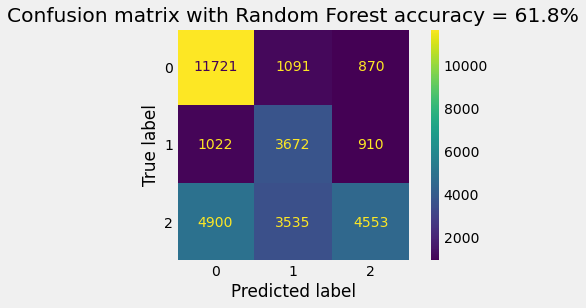

In [109]:
cmrf = confusion_matrix(Ytest, Ypredrf,labels=model_rf.classes_)
disprf = ConfusionMatrixDisplay(cmrf,display_labels=model_rf.classes_)
disprf.plot()
plt.grid(False)
plt.title('Confusion matrix with Random Forest accuracy = '+str(accu_rf)+'%')
plt.show()

On constate que la deuxième classe est très mal prédite. Nous utilisons maintenant une RandomSearch pour commencer à optimiser les hyperparamètres du modèle.

#### Tuning des hyperparamètres 

##### Tuning plus large mais plus rapide : le Random Search

In [149]:
params_rf = {
    'n_estimators': [50,100,200],
    'max_depth': [3,5,7,9],
    'min_samples_leaf': [1, 2, 4],
    'min_samples_split': [2, 5, 10]
}
#nous créons notre grille d'hyperparamètres.

In [150]:
base_rfmodel = RandomForestClassifier()

In [151]:
folds = 3
param_comb = 7
# nous faisons de la 3-fold cross validation et nous testons 7 combinaisons d'hyperparamètres dans la RandomSearch.

In [152]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42)

random_search_rf = RandomizedSearchCV(base_rfmodel, param_distributions=params_rf, 
                                   n_iter=param_comb,scoring='accuracy', n_jobs=-1,
                                   cv=skf.split(Xtrain_final, Ytrain_final), verbose=3, random_state=42)

random_search_rf.fit(Xtrain_final, Ytrain_final)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

Fitting 3 folds for each of 7 candidates, totalling 21 fits


RandomizedSearchCV(cv=<generator object _BaseKFold.split at 0x7f85c7798740>,
                   estimator=RandomForestClassifier(), n_iter=7, n_jobs=-1,
                   param_distributions={'max_depth': [3, 5, 7, 9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [50, 100, 200]},
                   random_state=42, scoring='accuracy', verbose=3)

In [153]:
print(random_search_rf.cv_results_)

{'mean_fit_time': array([10.08389735,  3.15354745,  3.07470759, 10.72259927,  8.45741884,
        4.22349119,  1.50138664]), 'std_fit_time': array([0.03505558, 0.09286294, 0.12691857, 0.82281581, 0.45482878,
       0.3294524 , 0.02712426]), 'mean_score_time': array([0.66613738, 0.2822202 , 0.26801006, 0.7496864 , 0.53408337,
       0.30876048, 0.10564129]), 'std_score_time': array([0.01718013, 0.01905858, 0.03926116, 0.04981859, 0.06410533,
       0.08478697, 0.00755946]), 'param_n_estimators': masked_array(data=[200, 100, 100, 200, 200, 100, 50],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_min_samples_split': masked_array(data=[5, 2, 5, 2, 10, 5, 5],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_min_samples_leaf': masked_array(data=[4, 2, 1, 1, 1, 2, 1],
             mask=[False, False, False, False, False, False, False],
   

In [154]:
print(random_search_rf.best_estimator_)
#renvoie les modèle qui a obtenu la meilleure précision

RandomForestClassifier(max_depth=9, n_estimators=200)


In [155]:
print(random_search_rf.best_params_)

{'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 9}


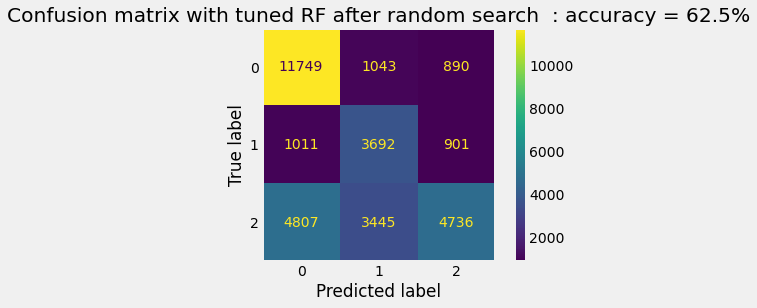

In [156]:
rf_best = random_search_rf.best_estimator_ # on utilise le meilleur modèle de notre RandomSearch
rf_best.fit(Xtrain_final, Ytrain_final)

Ypredrf_best = rf_best.predict(Xtest_final)
test_acc_rf_best = accuracy_score(Ytest_final, Ypredrf_best)
accu_rf_best = round(test_acc_rf_best,3)*100
test_f1score_rf_best = f1_score(Ytest_final, Ypredrf_best, average='weighted')
f1score_rf_best = round(test_f1score_rf_best,3)*100


cmrf_best = confusion_matrix(Ytest_final, Ypredrf_best,labels=rf_best.classes_)
disprf_best = ConfusionMatrixDisplay(cmrf_best,display_labels=rf_best.classes_)
disprf_best.plot()
plt.title('Confusion matrix with tuned RF after random search  : accuracy = '+str(accu_rf_best)+'%')
plt.grid(False)
plt.show()

In [157]:
f1score_rf_best

60.699999999999996

On obtient un F1 score de 61% avec le tuning des hyperparamètres du modèle de Random Forest par Random Search. 

##### Affinage du tuning avec Grid Search

RandomSearch permet de tester aléatoirement des combinaisons pour trouver des hyperparamètres. Ainsi, cela nous a permis d'avoir une vision générale et approximative des hyperparamètres. Maintenant, on peut utiliser un Gridsearch qui teste toutes les combinaisons qu'on lui indique afin d'optimiser et d'affiner les hyperparamètres. 

In [158]:
params_grid_rf = {
    'n_estimators': [150,175,200],
    'max_depth': [8,9,10,11],
    'min_samples_leaf': [1, 2,3],
    'min_samples_split': [1,2,3,4]
}
#nous créons notre grille d'hyperparamètres affinée pour le GridSearch.

In [159]:
base_rfmodel = RandomForestClassifier()

In [160]:
folds = 3

# nous faisons de la 3-fold cross validation 

In [161]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42)

grid_search_rf = GridSearchCV(base_rfmodel, param_grid=params_grid_rf, scoring='accuracy', n_jobs=-1,
                                   cv=skf.split(Xtrain_final,Ytrain_final), verbose=3)

grid_search_rf.fit(Xtrain_final,Ytrain_final)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

Fitting 3 folds for each of 144 candidates, totalling 432 fits


GridSearchCV(cv=<generator object _BaseKFold.split at 0x7f85839345f0>,
             estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [8, 9, 10, 11],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [1, 2, 3, 4],
                         'n_estimators': [150, 175, 200]},
             scoring='accuracy', verbose=3)

In [162]:
#print(grid_search_rf.cv_results_)

In [163]:
print(grid_search_rf.best_estimator_)
#renvoie les modèle qui a obtenu la meilleure précision

RandomForestClassifier(max_depth=11, n_estimators=200)


In [164]:
print(grid_search_rf.best_params_)

{'max_depth': 11, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


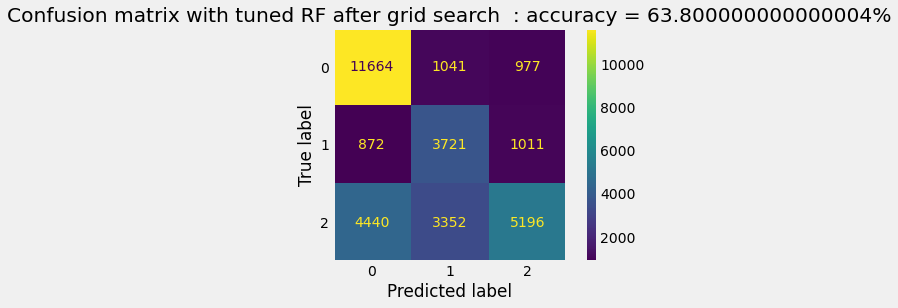

In [165]:
rf_best = grid_search_rf.best_estimator_ # on utilise le meilleur modèle de notre RandomSearch
rf_best.fit(Xtrain_final,Ytrain_final)

Ypredrf_best = rf_best.predict(Xtest_final)
test_acc_rf_best = accuracy_score(Ytest_final, Ypredrf_best)
accu_rf_best = round(test_acc_rf_best,3)*100
test_f1score_rf_best = f1_score(Ytest_final, Ypredrf_best, average='weighted')
f1score_rf_best = round(test_f1score_rf_best,3)*100

cmrf_best = confusion_matrix(Ytest_final, Ypredrf_best,labels=rf_best.classes_)
disprf_best = ConfusionMatrixDisplay(cmrf_best,display_labels=rf_best.classes_)
disprf_best.plot()
plt.title('Confusion matrix with tuned RF after grid search  : accuracy = '+str(accu_rf_best)+'%')
plt.grid(False)
plt.show()

In [166]:
f1score_rf_best

62.4

On observe une légère amélioration de l'accuracy (63.8%) et du F1 score (62.4%) mais la classe 2 reste toujours assez mal prédite, malgré une certaine amélioration. 

Le gridsearch était plutôt long (10 minutes environ) et le gain négligeable (environ 1.5% d'accuracy en plus et % d'amélioration pour le F1-score), il est raisonnable de passer à un autre modèle que les random forests, même si on constate tout de même que la classe 2 est un peu mieux prédite désormais. 

### Deuxième modèle : XGBoost

XGBoost est un algorithme de machine learning appartenant à la classe des algorithmes utilisant le Gradient Boosting. Cela signifie qu'il ne construit pas une forêt d'arbres de décision indépendants pour prédire mais au contraire qu'il construit chaque nouvel arbre de décision en utilisant les erreurs commises par les précédents. L'apprentissage est donc séquentiel et non plus en parallèle.

XGBoost est notamment très utilisé pour les compétitions Kaggle et notamment par les vainqueurs, il domine actuellement les autres algorithmes en termes de performance et de vitesse.

In [167]:
model_xgb = XGBClassifier(objective='multi:softprob',learning_rate=0.3,max_depth=4,subsample=0.75,n_estimators=150) # nous testons un premier modèle
# avec des paramètres pris au hasard

In [168]:
model_xgb.fit(Xtrain_final,Ytrain_final)

Ypredxgb = model_xgb.predict(Xtest_final)
test_acc_xgb = accuracy_score(Ytest_final, Ypredxgb)
accu_xgb = round(test_acc_xgb*100,1)

test_f1score_xgb = f1_score(Ytest_final, Ypredxgb, average='weighted')
f1score_xgb = round(test_f1score_xgb,3)*100

In [169]:
accu_xgb

67.8

In [170]:
f1score_xgb

67.80000000000001

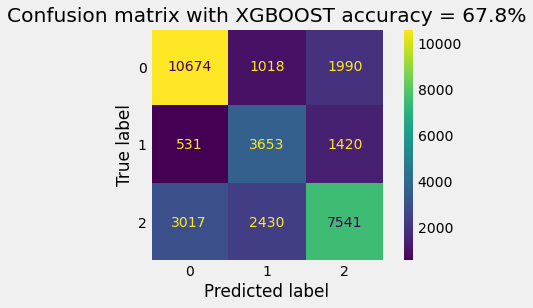

[CV 2/3] END max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100;, score=0.591 total time=   2.2s
[CV 3/3] END max_depth=3, min_samples_leaf=1, min_samples_split=5, n_estimators=100;, score=0.592 total time=   2.0s
[CV 2/3] END max_depth=7, min_samples_leaf=1, min_samples_split=10, n_estimators=200;, score=0.632 total time=   8.1s
[CV 1/3] END max_depth=8, min_samples_leaf=1, min_samples_split=1, n_estimators=200;, score=0.642 total time=   9.3s
[CV 3/3] END max_depth=8, min_samples_leaf=1, min_samples_split=2, n_estimators=175;, score=0.643 total time=   8.4s
[CV 2/3] END max_depth=8, min_samples_leaf=1, min_samples_split=3, n_estimators=175;, score=0.641 total time=   7.7s
[CV 1/3] END max_depth=8, min_samples_leaf=1, min_samples_split=4, n_estimators=175;, score=0.642 total time=   7.4s
[CV 3/3] END max_depth=8, min_samples_leaf=2, min_samples_split=1, n_estimators=150;, score=0.643 total time=   7.1s
[CV 2/3] END max_depth=8, min_samples_leaf=2, min_samples_split

In [171]:
cmxgb = confusion_matrix(Ytest_final, Ypredxgb,labels=model_xgb.classes_)
dispxgb = ConfusionMatrixDisplay(cmxgb,display_labels=model_xgb.classes_)
dispxgb.plot()
plt.title('Confusion matrix with XGBOOST accuracy = '+str(accu_xgb)+'%')
plt.grid(False)
plt.show()

On constate qu'on a une meilleure accuracy et un meilleur F1-score avec ce modèle XGBoost : environ 68% (donc au-dessus de 2/3 pour la prédiction) pour ces deux scores. La matrice de confusion indique aussi que la classe 2 est beaucoup mieux prédite qu'avec l'ancien Random Forest. Ce modèle semble très performant et on peut chercher à optimiser certains paramètres. 

#### Tuning des hyperparamètres 

##### RandomSearch pour tuner les hyperparamètres

In [304]:
params_xgb = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5],
        'learning_rate' : [0.1,0.3,0.5,0.7],
        'n_estimators': [75,100,150,200]
        }
# nous créons notre grille d'hyperparamètres à tester

In [346]:
xgb = XGBClassifier(objective='multi:softprob',silent=True, nthread=1)

In [347]:
folds = 3
param_comb = 7
# nous faisons de la 3-fold cross validation et nous testons 7 combinaisons d'hyperparamètres dans la RandomSearch.

In [348]:
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state =42,)

random_search_xgb = RandomizedSearchCV(xgb, param_distributions=params_xgb, 
                                   n_iter=param_comb,scoring='accuracy',
                                   cv=skf.split(Xtrain,Ytrain), verbose=3, random_state=42)

random_search_xgb.fit(Xtrain,Ytrain)
# nous faisons de la random_search en cross-validation avec un paramètre de folds déjà défini plus haut. 

Fitting 3 folds for each of 7 candidates, totalling 21 fits
[16:17:48] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.

[CV 1/3] END gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0;, score=0.725 total time= 2.8min
[16:20:33] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.

[CV 2/3] END gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0;, score=0.723 total time= 2.8min
[16:23:19] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.

[CV 3/3] END gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0;, score=0.724

RandomizedSearchCV(cv=<generator object _BaseKFold.split at 0x7f9a1e4003c0>,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, gpu_id=None,
                                           grow_policy=None,
                                           importance_type...
                                           monotone_constraints=None,
                                           n_estimators=100, n_jobs=None,
                                           nthread=1, num_parallel_tree=None,
                                           objective='multi:softprob', ...),
                   n_iter=7,
                   param_distributions={'gamma': [0.5, 1, 1.5, 2, 5],
                                        'learning_rate': [0.1, 0.3, 0.5, 0.7],
                                        'max_depth': [3, 4, 5],
                                        'min_child_weight': [1, 5, 10],
                                        'n_estimators': [75, 100, 150, 200],
                                        'subsample': [0.6, 0.8, 1.0]},
                   random_state=42, scoring='accuracy', verbose=3)

In [349]:
print(random_search_xgb.cv_results_)

{'mean_fit_time': array([165.82216899, 234.45102803,  67.07788507,  76.74943654,
       114.82571586, 143.96344527,  67.33145372]), 'std_fit_time': array([0.94573247, 2.01762139, 0.02868043, 0.1517656 , 0.18426618,
       0.47912913, 0.15455015]), 'mean_score_time': array([0.43445404, 0.54400404, 0.3099304 , 0.29506842, 0.33637023,
       0.37176243, 0.30767504]), 'std_score_time': array([0.00701579, 0.00655317, 0.00137755, 0.00107343, 0.0049816 ,
       0.0038601 , 0.00136819]), 'param_subsample': masked_array(data=[1.0, 0.8, 1.0, 0.6, 0.6, 0.8, 1.0],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_n_estimators': masked_array(data=[150, 200, 75, 100, 150, 200, 75],
             mask=[False, False, False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_min_child_weight': masked_array(data=[10, 10, 5, 5, 5, 10, 5],
             mask=[False, False, False, False, False, Fals

In [350]:
print(random_search_xgb.best_estimator_)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=1, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.7, max_bin=256,
              max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
              max_depth=5, max_leaves=0, min_child_weight=10, missing=nan,
              monotone_constraints='()', n_estimators=150, n_jobs=1, nthread=1,
              num_parallel_tree=1, objective='multi:softprob', ...)


In [351]:
print(random_search_xgb.best_params_)

{'subsample': 1.0, 'n_estimators': 150, 'min_child_weight': 10, 'max_depth': 5, 'learning_rate': 0.7, 'gamma': 1}


Pour info, 2 bons modèles : gamma=1, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=150, subsample=1.0
(et gamma=1.5, learning_rate=0.7, max_depth=5, min_child_weight=10, n_estimators=200, subsample=0.8) sont sortis par le Random Search. 

[17:05:38] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "silent" } are not used.



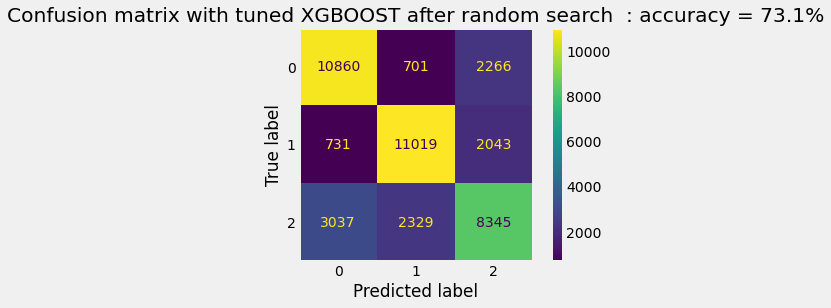

In [352]:
xgb_best = random_search_xgb.best_estimator_
xgb_best.fit(Xtrain,Ytrain)

Ypredxgb_best = xgb_best.predict(Xtest)
test_acc_xgb_best = accuracy_score(Ytest, Ypredxgb_best)
accu_xgb_best = round(test_acc_xgb_best,3)*100

cmxgb_best = confusion_matrix(Ytest, Ypredxgb_best,labels=xgb_best.classes_)
dispxgb_best = ConfusionMatrixDisplay(cmxgb_best,display_labels=xgb_best.classes_)
dispxgb_best.plot()
plt.grid(False)
plt.title('Confusion matrix with tuned XGBOOST after random search  : accuracy = '+str(accu_xgb_best)+'%')
plt.show()

On remarque que les classes 0 (indemne) et 1 (tué et bléssé hospitalisé) sont plutôt très bien prédites par notre modèle. A l'inverse, la classe 2 (bléssé léger) semble être un peu moins évidente à prédire pour notre modèle, même si elle reste tout de même bien prédite, comme l'indique la matrice de confusion.

On pourrait affiner avec un GridSearch mais le temps de calcul serait trop long (il prend déja 45 minutes pour un Random Search avec 21 fits) donc on garde les paramètres choisis avec un RandomSearch pour notre modèle. 

On constate qu'on a de biens meilleurs résultats avec le modèle XGBoost qu'avec le Random Forest. En effet, notre modèle réussit à prédire avec une accuracy de plus de 73% la bonne classe de gravité d'accident : indemne, blessé léger ou blessé grave/hospitaliser et tué. Ce résultat est très satisfaisant. 

On a aussi eu envie de tester un SVM (avec kernel = rbf). 

En effet, l’une des méthodes de Machine Learning les plus utilisées en classification est les SVM (Support Vector Machines). Il s’agit de trouver, dans un système de projection adéquat (noyau ou kernel), les paramètres de l’hyperplan (en fait d’un hyperplan à marges maximales) séparant les classes de données. 

Cependant, ce modèle est un des plus longs et il tournait trop longtemps. Ainsi, au regard des résultats très satisfaisants du modèle XGBoost, nous avons choisi de garder celui-ci pour notre modélisation. 

## APPROFONDISSEMENTS : FEATURE IMPORTANCE & SHAP

On veut maintenant savoir sur quelles informations se base notre modèle pour effectuer ses prédéctions. En d'autres termes, quelles sont les variables les plus influentes pour prédire la gravité d'un accident de voiture ?

Pour cela, nous allons dans un premier temps utiliser la méthode de feature importance de scikit-learn puis la bibliothèque SHAP.

### Feature importance 

Pour ce faire, on va uniquement tester sur un XGBoost dont les paramètres sont ceux trouvés avec le Random Search correspondant avec les variables catégorielles non encodées. 

En effet, on constate que XGBoost s'adapte bien aux données catégorielles non encodées car il donne des résultats très similaires à ceux obtenus avec des variables catégorielles encodées. Ceci peut s'expliquer par le fait que les variables possédaient déjà une sorte d'encodage naturel car elles étaient catégorielles mais prenaient des valeurs espacées d'une unité. On peut ainsi tester le XGBoost sans nos données encodées pour cette partie. Cela nous permettra de voir plus facilement l'importance de chaque feature dans la prédiction du modèle. 

In [228]:
XsmotedNC, YsmotedNC

(        place  sexe      an_nais  secu1  catv  obsm  choc  manv  motor  vma  \
 0           1     1  1998.000000      2    33     2     1     1      1   50   
 1           2     1  1966.000000      1     7     0     0    17      1   70   
 2           1     2  1940.000000      1     7     1     1    16      1   50   
 3           1     2  1993.000000      1     7     2     1     1      1   90   
 4           1     1  1957.000000      1     7     0     2    20      1   30   
 ...       ...   ...          ...    ...   ...   ...   ...   ...    ...  ...   
 124273      1     1  1998.825373      2    33     2     1     2      1   50   
 124274      1     1  2005.325679      2     2     2     1     1      1   50   
 124275     10     2  2004.000000      0     7     1     2    17      1   50   
 124276      9     2  1971.775191      8    37     2     3     1      1   50   
 124277      1     1  1989.704234      1     7     0     0     2      1   70   
 
         lum  int  atm       lat2     

In [229]:
model_xgb_bis = XGBClassifier(objective='multi:softprob',learning_rate=0.7,max_depth=5,subsample=1,n_estimators=150) # nous testons un premier modèle

In [230]:
model_xgb_bis.fit(XsmotedNC,YsmotedNC)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.7, max_bin=256,
              max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
              max_depth=5, max_leaves=0, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=150, n_jobs=0,
              num_parallel_tree=1, objective='multi:softprob', predictor='auto', ...)

In [231]:
Ypredxgbbis = model_xgb_bis.predict(Xtest)
test_acc_xgb_bis = accuracy_score(Ytest, Ypredxgbbis)
accu_xgb_bis = round(test_acc_xgb_bis*100,1)

test_f1score_xgb_bis = f1_score(Ytest, Ypredxgbbis, average='weighted')
f1score_xgb_bis = round(test_f1score_xgb_bis*100,1)

In [232]:
accu_xgb_bis

68.7

In [233]:
f1score_xgb_bis

68.6

On obtient une accuracy et un f1 socre d'environ 69%, ce qui est très satisfaisant. 

La matrice de confusion ci-après montre que les classes de gravité 0 et 2 sont très bien prédites, et la classe 1 est un petit peu moins bien prédite. 

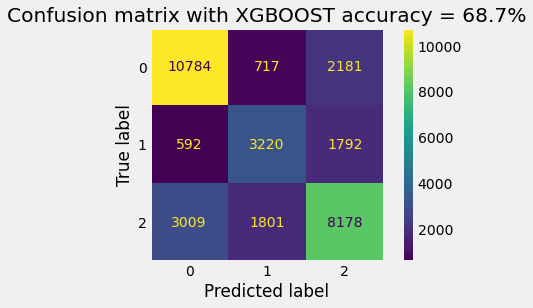

In [184]:
cmxgb_bis = confusion_matrix(Ytest, Ypredxgbbis,labels=model_xgb_bis.classes_)
dispxgb_bis = ConfusionMatrixDisplay(cmxgb_bis,display_labels=model_xgb_bis.classes_)
dispxgb_bis.plot()
plt.title('Confusion matrix with XGBOOST accuracy = '+str(accu_xgb_bis)+'%')
plt.grid(False)
plt.show()

La feature importance fait référence à des techniques qui calculent un score pour toutes les caractéristiques d'entrée d'un modèle donné - les scores représentent simplement l'"importance" de chaque caractéristique. Un score plus élevé signifie que la caractéristique spécifique aura un effet plus important sur le modèle qui est utilisé pour prédire une certaine variable.

La feature importance est extrêmement utile pour les raisons suivantes :

**1) Compréhension des données** : 
En effet, construire un modèle est une chose, mais comprendre les données qui entrent dans le modèle en est une autre. Comme une matrice de corrélation, l'importance des caractéristiques vous permet de comprendre la relation entre les caractéristiques et la variable cible. Elle vous aide également à comprendre quelles caractéristiques ne sont pas pertinentes pour le modèle.

**2) Amélioration du modèle** : 
Lors de la formation de notre modèle, on peut utiliser les scores calculés à partir de l'importance des caractéristiques pour réduire la dimensionnalité du modèle. Les scores les plus élevés sont généralement conservés et les scores les plus faibles sont supprimés car ils ne sont pas importants pour le modèle. Cela permet non seulement de simplifier le modèle, mais aussi d'en accélérer le fonctionnement, ce qui améliore finalement les performances du modèle.

**3) Interprétabilité du modèle** : 
Le feature importance est également utile pour interpréter et communiquer notre modèle aux autres parties prenantes. En calculant les scores pour chaque caractéristique, on peut déterminer quelles caractéristiques attribuent le plus au pouvoir prédictif de votre modèle.

La librairie xgboost propose directement plusieurs types de features importance. 

In [185]:
model_xgb_bis.feature_importances_

array([0.11259989, 0.08962157, 0.02996245, 0.23206319, 0.04984194,
       0.19168639, 0.03809441, 0.03344961, 0.03956765, 0.06989593,
       0.01696577, 0.02418838, 0.01977682, 0.03049404, 0.02179188],
      dtype=float32)

<BarContainer object of 15 artists>

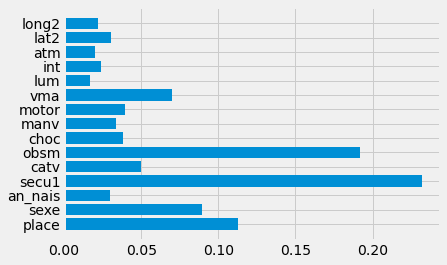

In [186]:
plt.barh(XsmotedNC.columns, model_xgb_bis.feature_importances_)

Ce graphique représente la Feature importance "gain".

Il s’agit de la moyenne de la réduction de la fonction coût (pour les données d’entraînement) quand une variable est utilisée pour une division au niveau d’un noeud.

Ainsi, les features secu1, obsvm, place et sexe sont ceux qui permettent le plus de réduire la fonction coût. 

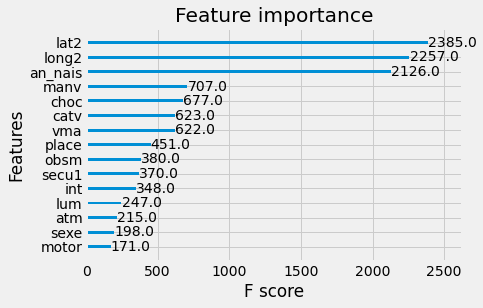

In [187]:
xgboost.plot_importance(model_xgb_bis,max_num_features=20)
plt.title("Feature importance")
plt.show()

Ce graphique représente la Feature importance "weight".

Il s’agit du nombre de fois où une variable est utilisée pour diviser les données à travers l’ensemble des arbres.

Ainsi, les features lat2, long2 et an_nais sont ceux qui sont le plus utilisés pour diviser les données à travers l’ensemble des arbres et donc pour participer à la décision de ces arbres. 

### Feature selection 

On peut essayer de faire de la Feature Selection en regardadnt l'effet d'enlever les variables avec les plus faibles feature importances sur les scores du modèle XGBoost. 

Pour ce faire, on utilise mutual_info_classif et SelectKBest. 

mutual_info_classif estime l'information mutuelle pour des catégories fixes comme dans un problème de classification ou une variable cible continue dans les problèmes de régression. L'information mutuelle fonctionne sur l'entropie des variables.

L’entropie nous permet donc de mesurer l’information moyenne que nous apporte une mesure d’un événement issu de la distribution de X. Plus cette information moyenne sera importante, plus cela signifie que la distribution de X est “aléatoire”, dans le sens où on a besoin de mesurer la prochaine valeur pour obtenir un maximum d’information.
  
L'information mutuelle (IM) entre deux variables aléatoires est une valeur non négative qui mesure la dépendance entre les variables. Elle est égale à zéro si et seulement si deux variables aléatoires sont indépendantes, et des valeurs plus élevées signifient une plus grande dépendance.
En bref, il s'agit de la quantité d'informations qu'une variable donne sur l'autre.
Prenons deux variables aléatoires, l'information mutuelle entre elles sera nulle si et seulement si les variables sont complètement indépendantes, sinon l'information mutuelle entre elles sera symétrique et non négative.

In [336]:
from sklearn.feature_selection import mutual_info_classif

In [337]:
mutual_info = mutual_info_classif(XsmotedNC, YsmotedNC)

In [338]:
mutual_info = pd.Series(mutual_info)
mutual_info.index = XsmotedNC.columns
mutual_info.sort_values(ascending=False)

an_nais    0.223254
secu1      0.135719
catv       0.101431
long2      0.096253
lat2       0.095959
vma        0.062140
manv       0.054817
choc       0.041468
place      0.038511
obsm       0.036135
sexe       0.032441
motor      0.027688
int        0.012886
lum        0.009127
atm        0.008896
dtype: float64

<AxesSubplot:>

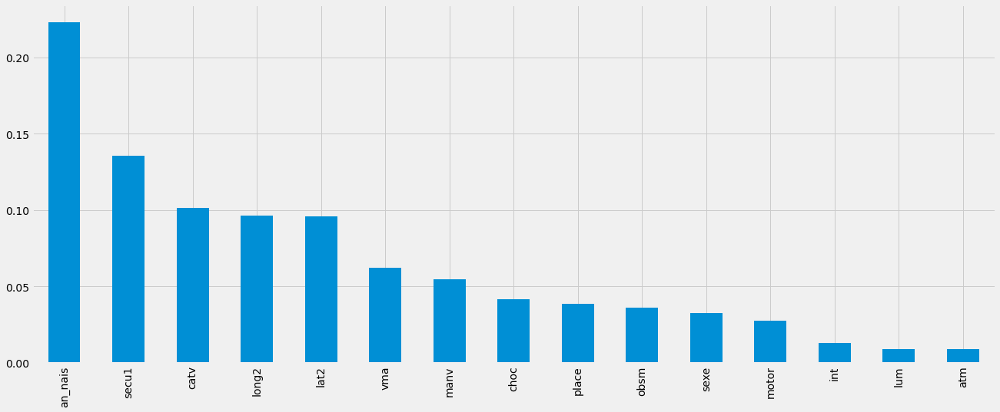

In [339]:
mutual_info.sort_values(ascending=False).plot.bar(figsize=(20, 8))

On observe ainsi que an_nais a la plus forte information mutuelle tandis que sexe, motor, int, lum et atm ont la moins forte information mutuelle. Ces 5 dernières valeurs correspondent d'ailleurs aux 5 plus faibles importances de features selon la Feature Importance de type "weight" du xgboost défini au-dessus. 

Ainsi, on peut utiliser SelectKBest pour tenter de voir l'effet d'éliminer ces 5 variables du dataset sur les scores d'accuracy et F1. 

In [340]:
from sklearn.feature_selection import SelectKBest

sel_ten_cols = SelectKBest(mutual_info_classif, k=10)
sel_ten_cols.fit(XsmotedNC, YsmotedNC)
XsmotedNC.columns[sel_five_cols.get_support()]

Index(['place', 'an_nais', 'secu1', 'catv', 'obsm', 'choc', 'manv', 'vma',
       'lat2', 'long2'],
      dtype='object')

On recrée un nouveau modèle come d'habitude afin d'éavluer le F1 score et l'accuracy avec ce modèle duquel on a retiré 5 features. 

In [382]:
Y_new = dfmodel['grav']
X_new = dfmodel.drop(['grav','atm','int','sexe','lum','motor'],axis = 1)

In [383]:
X_new.columns

Index(['place', 'an_nais', 'secu1', 'catv', 'obsm', 'choc', 'manv', 'vma',
       'lat2', 'long2'],
      dtype='object')

In [384]:
median_new = X_new['an_nais'].median()
X_new['an_nais'].fillna(median_new, inplace=True)

In [385]:
Xtrain_new, Xtest_new, Ytrain_new, Ytest_new = train_test_split(X_new,Y_new)

In [386]:
var_categoriques_new = [0,2,3,4,5,6] #indices des colonnes de features catégoriques
smNC_new = SMOTENC(categorical_features=var_categoriques_new)
XsmotedNC_new, YsmotedNC_new = smNC_new.fit_resample(Xtrain_new,Ytrain_new)

In [387]:
model_xgb_new = XGBClassifier(objective='multi:softprob',learning_rate=0.7,max_depth=5,subsample=1,n_estimators=150) 
# Nous testons un premier modèle avec des paramètres sélectionnés grâce au Random Search

In [388]:
model_xgb_new.fit(Xtrain_new,Ytrain_new)

Ypredxgb_new = model_xgb_new.predict(Xtest_new)
test_acc_xgb_new = accuracy_score(Ytest_new, Ypredxgb_new)
accu_xgb_new = round(test_acc_xgb_new*100,1)

test_f1score_xgb_new = f1_score(Ytest_new, Ypredxgb_new, average='weighted')
f1score_xgb_new = round(test_f1score_xgb_new*100,1)

In [389]:
accu_xgb_new

68.3

In [390]:
f1score_xgb_new

67.8

On remarque qu'on n'a pas obtenu de meilleurs scores que précédemment. Cependant, malgré le fait d'avoir enlevé 5 features sur 15 initiaux, on constate qu'on n'a quasiment les mêmes valeurs d'accuracy et de F1 score (un peu moins élevé). Cela permet donc de mettre en avant le fait que ces 5 features n'étaient pas si utiles pour améliorer la prédiction du modèle puisqu'ils l'améliorent si peu lorsqu'on les ajoute. 

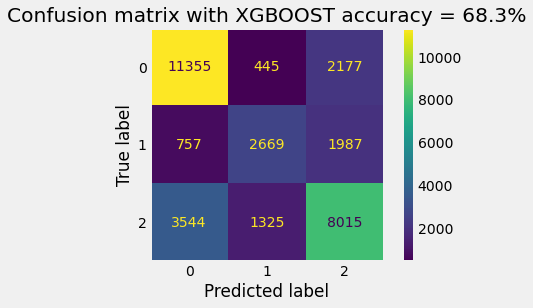

In [391]:
cmxgb_new = confusion_matrix(Ytest_new, Ypredxgb_new,labels=model_xgb_new.classes_)
dispxgb_new = ConfusionMatrixDisplay(cmxgb_new,display_labels=model_xgb_new.classes_)
dispxgb_new.plot()
plt.title('Confusion matrix with XGBOOST accuracy = '+str(accu_xgb_new)+'%')
plt.grid(False)
plt.show()

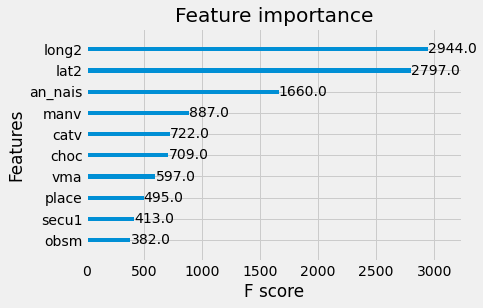

In [392]:
xgboost.plot_importance(model_xgb_new,max_num_features=20)
plt.title("Feature importance")
plt.show()

### SHAP

SHAP (SHapley Additive exPlanations) est une approche de la théorie des jeux qui permet d'expliquer les résultats de tout modèle d'apprentissage automatique (ML).

En résumé, les valeurs de Shapley calculent l’importance d’une variable en comparant ce qu’un modèle prédit avec et sans cette variable. Cependant, étant donné que l’ordre dans lequel un modèle voit les variables peut affecter ses prédictions, cela se fait dans tous les ordres possibles, afin que les fonctionnalités soient comparées équitablement. Cette approche est inspirée de la théorie des jeux.

SHAP s’utilise pour expliquer un modèle existant. Prenant un cas de classification binaire construite avec un modèle sklearn. On entraine, tune et teste notre modèle. Ensuite on peut utiliser nos données et le modèle pour créer un modèle supplémentaire de SHAP qui explique notre modèle de classification.

On l'utilise ici pour interpréter notre modèle XGBoost utilisé pour notre problème de classification. 

In [330]:
!pip install shap

In [394]:
import shap

In [395]:
#shap.initjs()
explainer = shap.TreeExplainer(model_xgb_bis)
shap_values = explainer.shap_values(XsmotedNC)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


#### SHAP Summary Plot 

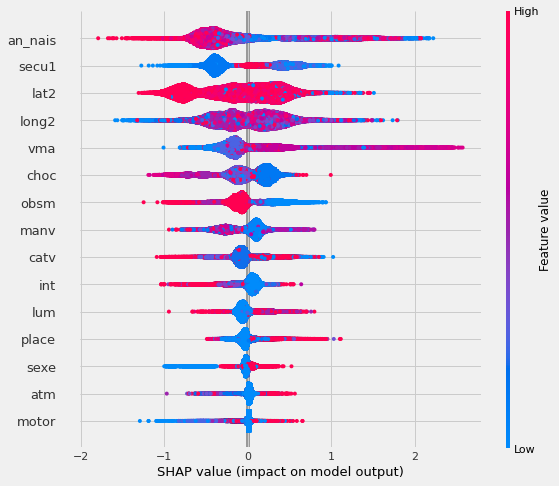

In [396]:
shap.summary_plot(shap_values[1],XsmotedNC)

Cette figure représente l’importance globale des variables calculées sur la prédiction de la classe 1 par les valeurs de Shap. Grâce au fait que les valeurs sont calculées pour chaque exemple du dataset, il est possible de représenter chaque exemple par un point et ainsi avoir une information supplémentaire sur l’impact de la variable en fonction de sa valeur. Par exemple, ici, 'an_nais' a un impact négatif quand la valeur de cette variable est élevée (points rouges à gauche). Autrement dit, une forte valeur d'année de naissance (donc être plus jeune) diminue la probabilité d'appartenir à la classe 1 (tué et hospitalisé). De la même manière, 'vma' a un impact positif quand la valeur de cette variable est élevée (points rouges à droite) : une haute valeur de 'vma', donc une grade vitesse autorisée sur la route, augmente la probabilité d'appartenir à la classe 1 des tués et hospitalisés, ce qui semble plutôt logique. 

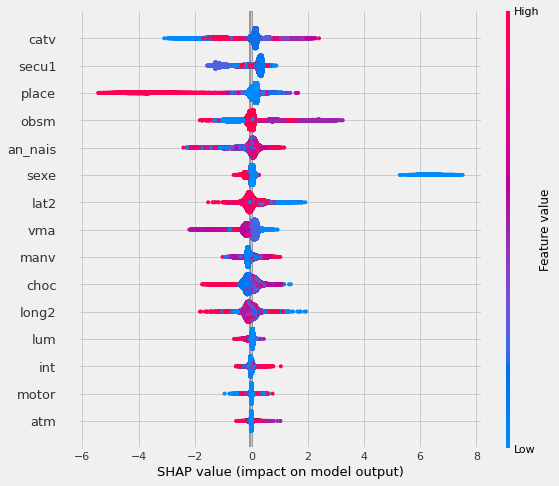

In [398]:
shap.summary_plot(shap_values[0],XsmotedNC)

Par exemple, ici, 'place' a un impact négatif sur la prédiction de la valeur de gravité égale à 0 (indemne) quand la valeur de cette variable est élevée : être à la place du mort ou piéton diminue la probabilité d'être indemne lors d'un accident. De même, 'lat2' a un impact positif quand la valeur de cette variable est faible (points bleus à droite). 

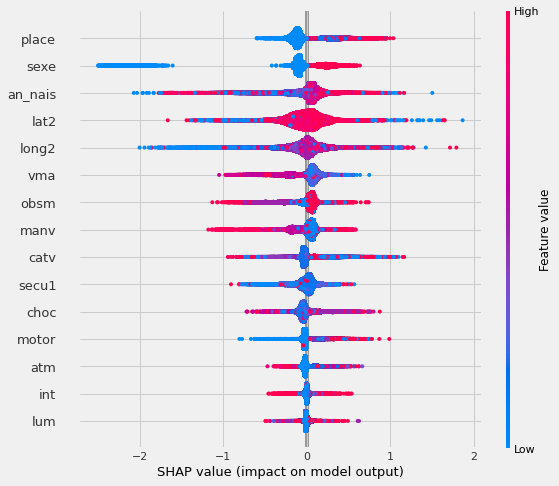

In [399]:
shap.summary_plot(shap_values[2],XsmotedNC)

Par exemple, ici, 'long2' a un impact négatif sur la prédiction de la valeur de gravité égale à 2 (blessé léger) quand la valeur de cette variable est faible. 

#### SHAP Force Plot 

On peut aussi, à l'aide de SHAP, expliquer l'impact des variables pour des exemples du dataset. En rouge, on dispose des variables qui ont un impact positif (contribuent à ce que la prédiction soit plus élevée que la valeur de base) et, en bleu, celles ayant un impact négatif (contribuent à ce que la prédiction soit plus basse que la valeur de base)

In [402]:
shap.initjs()
shap.force_plot(explainer.expected_value[1],
shap_values[1][0,:], XsmotedNC.iloc[0,:])

Pour cet exemple du dataset, on constate que les variables 'manv', 'long2' 'catv', 'choc', 'secu1' et 'lat2' ont une valeur faible, ce qui contribue à auglmenter la probabilité que l'accident appartienne à un accident de classe 1 (accident grave). Au contraire, la valeur élevée de 'an_nais' et 'obsm' contribue, pour cet exemple, à diminuer la probabilité que l'acident soit grave. 

In [404]:
shap.initjs()
shap.force_plot(explainer.expected_value[1],
shap_values[0][10,:], XsmotedNC.iloc[10,:])

Pour cet exemple du dataset, on constate que les variables 'atm', 'an_nais' 'lat2', 'choc', 'catv','secu1' et 'place' ont une valeur faible, ce qui contribue à auglmenter la probabilité que l'accident appartienne à un accident de classe 0 (indemne donc accident moins grave). Au contraire, la valeur élevée de 'sexe', 'vma', 'lum' et 'long2' contribue, pour cet exemple, à diminuer la probabilité que l'acident soit non grave. 

#### SHAP Summary Plot Global 

Le summary_plot de SHAP permet aussi d'avoir une vue globale de l'importance des features pour prédire une certaine classe d'accidents. 

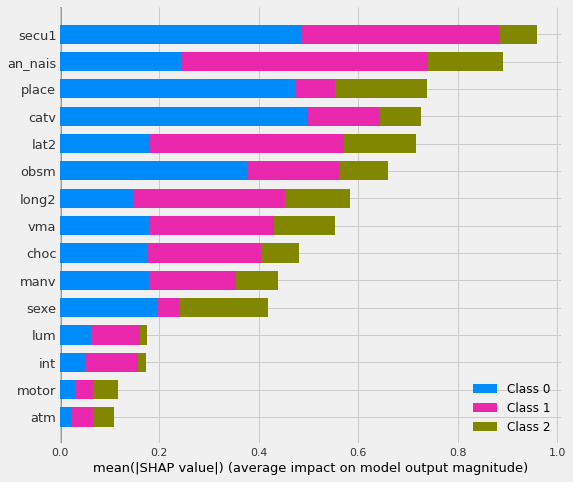

In [405]:
shap.summary_plot(shap_values,Xtest,max_display=30)

On observe que, pour le Xtest, secu1 a par exemple une importance considérable pour prédire la classe d'accident 0 et moins la classe 2. Le feature 'place' est celui qui a le plus d'importance pour prédire la classe 2 avec le 'sexe' selon ce summary_plot. L'année de naissance, quant à elle, a de l'importance pour prédire la classe 1. Globalement, les features 'an_nais', 'secu1' et 'place' semblent être ceux qui ont le plus d'importance pour la prédiction de la gravité de l'accident. 

#### SHAP Decision Plot 

Enfin, les decision_plot peuvent être tracés avec SHAP. Ils montrent comment des modèles complexes arrivent à leurs prédictions (c'est-à-dire, comment les modèles prennent des décisions). Un decision_plot peut révéler comment les prédictions changent à travers un ensemble de valeurs de caractéristiques. Cette méthode est utile pour présenter des scénarios hypothétiques et exposer les comportements des modèles.

In [408]:
shap_values_test = explainer.shap_values(Xtest)

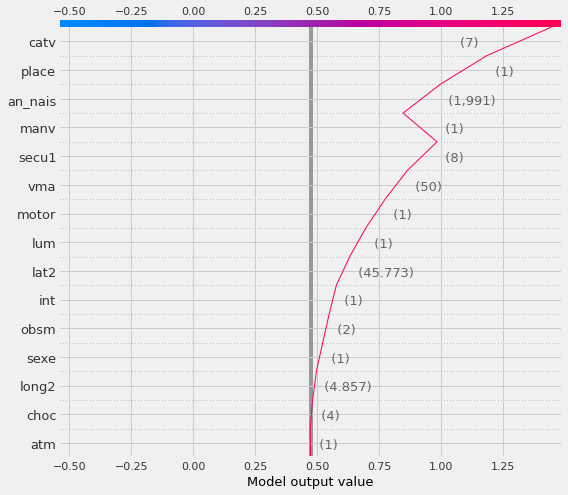

In [409]:
shap.initjs()
shap.decision_plot(explainer.expected_value[0], 
                shap_values_test[0][3,:], Xtest.iloc[3,:])

Par exemple, ici, pour un exemple du dataset, on observe comment le modèle complexe XGBoost utilisé arrive à sa oprédiction d'un accident de classe 0. 

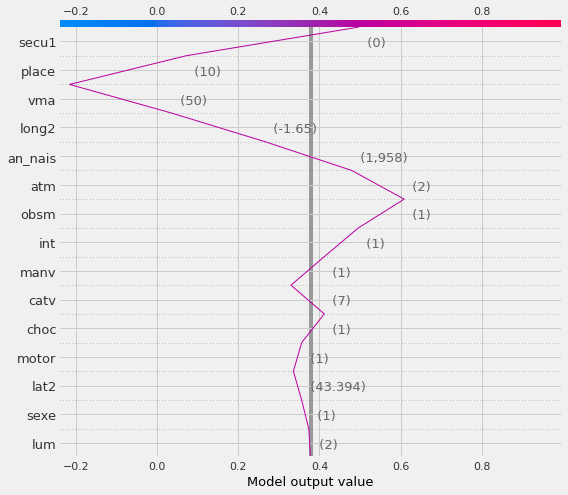

In [410]:
shap.initjs()
shap.decision_plot(explainer.expected_value[1], 
                shap_values_test[1][15,:], Xtest.iloc[15,:])

Par exemple, ici, pour un exemple du dataset, on observe comment le modèle complexe XGBoost utilisé arrive à sa oprédiction d'un accident de classe 1. 

## Conclusion du projet 

Ainsi, ce projet a été l'occasion pour notre binôme de nous familiariser avec le déroulement d'un projet de Data Scientist comprenant : la récupération et le nettoyage des données, l'utilisation de statistiques descriptives afin de choisir les données à conserver et à utiliser, la modélisation et l'utilisation de modèles complexes de Machine Learning, et enfin l'observation de la feature importance (avec feature selection éventuelle). 

De plus, ce projet nous tenait à coeur car il étaiut original, quoique traitant d'un sujet non joyeux, mais possédat une utilité publique et reposant sur des données fournies par le site du gouvernement datagouv.fr. 

Nous avons rencontré plusieurs difficultés dans ce projet, comme le choix des variables à utiliser come features et celles à éliminer parmi les très nombreuses variables présentes, mais aussi le fait d'avoir un dataset déséquilibré. Il nous a fallu nous renseigner beaucoup sur internet afin de déterminer comment traiter un problème de Machine Learning avec un dataset déséquilibré (utilisation du module SMOTENC), mais aussi de constament chercher à améliorer notre modèle et sa précision, en comprenant aussi quels scores étaient le plus adapté pour estimer la performance de notre modèle. 

Nous avons donc beaucoup progressé durant ce projet grâce aux nombreuses recherches réalisées pour y venir à bout, et grâce à notre volonté de rendre un travail le plus complet possible. 